# Gravity Data Processing

In [1]:
# ### Ehsan Farahbakhsh and Hugo W. Fahey

# *EarthByte Group, School of Geosciences, University of Sydney, NSW 2006, Australia*

# This notebook enables the user to pre-process the gravity dataset available for South Australia, reduce the dimensionality of 
# the dataset using the principal component analysis (PCA) method, and apply the k-means clustering method to the output components.

## Importing Libraries

In [2]:
import contextily as cx
import geopandas as gpd
from ipywidgets import interact
import math
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
import os
from osgeo import gdal, osr
import pandas as pd
import rioxarray as rxr
from scipy.interpolate import griddata
from shapely.geometry import mapping
from shapely.geometry import Point
from skimage import exposure, util
from skimage.feature import graycomatrix, graycoprops
from sklearn import cluster
from sklearn.decomposition import PCA
import sys
from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings('ignore')

## Importing Layers

### Vector Files

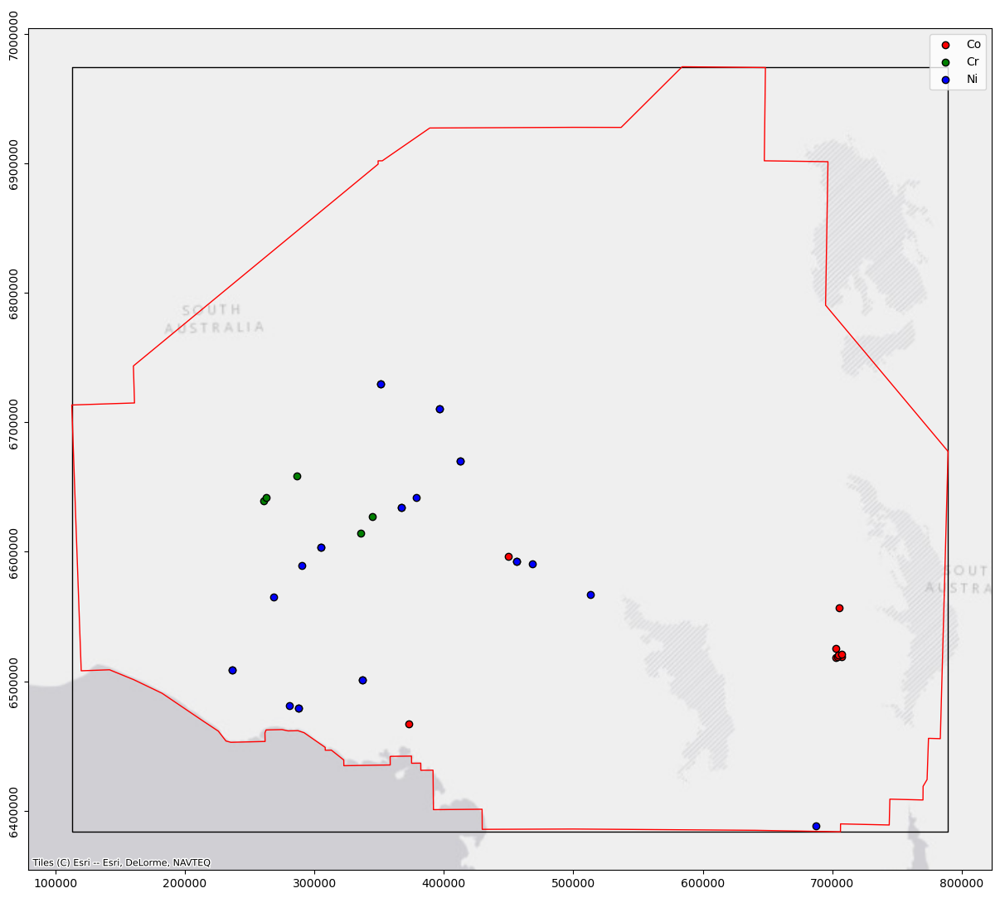

In [3]:
# read boundaries
gc_frame = gpd.read_file('./Datasets/Frames/GC_Frame_MGA53.shp')
gc_frame = gc_frame.to_crs('epsg:7853')
gc_polygon = gpd.read_file('./Datasets/Frames/GC_Polygon_MGA53.shp')
gc_polygon = gc_polygon.to_crs('epsg:7853')
bounds = gc_frame.bounds
extent = [bounds.loc[0]['minx'], bounds.loc[0]['maxx'], bounds.loc[0]['miny'], bounds.loc[0]['maxy']]

# mineral occurrences
mines_co = gpd.read_file('./Datasets/Mineral occurrences/cobalt.shp')
mines_co = mines_co.to_crs('epsg:7853')
mines_co = mines_co.clip(gc_polygon)
mines_cr = gpd.read_file('./Datasets/Mineral occurrences/chromium.shp')
mines_cr = mines_cr.to_crs('epsg:7853')
mines_cr = mines_cr.clip(gc_polygon)
mines_ni = gpd.read_file('./Datasets/Mineral occurrences/nickel.shp')
mines_ni = mines_ni.to_crs('epsg:7853')
mines_ni = mines_ni.clip(gc_polygon)

# target mineralization types
cox_class = ['Deposits related to mafic and ultramafic intrusions in stable environments',
             'Deposits related to mafic-ultramafic rocks in unstable areas']

# plot the mineral occurrences
fig, ax = plt.subplots(figsize=(15, 15))
mines_co.plot(ax=ax, edgecolor='black', color='red')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_frame.plot(ax=ax, edgecolor='black', color='none', linewidth=1)
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
# Esri: WorldStreetMap, DeLorme, WorldTopoMap, WorldImagery, WorldTerrain, WorldShadedRelief, WorldPhysical, OceanBasemap,
# NatGeoWorldMap, WorldGrayCanvas
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

### Bouger Anomaly

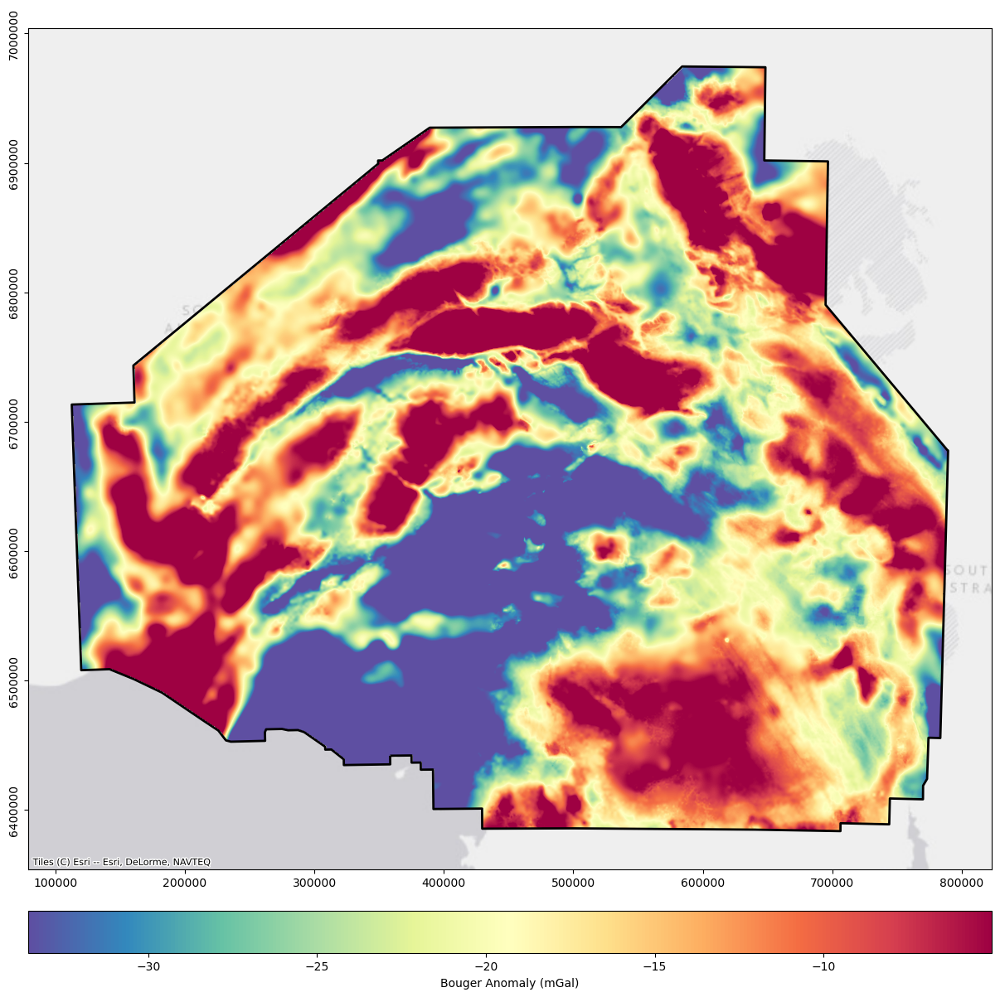

In [4]:
grav_file = './Datasets/Gravity/SA_GRAV.tif'

raster = rxr.open_rasterio(grav_file).squeeze()
raster = raster.rio.reproject(gc_frame.crs)
raster_clipped = raster.rio.clip(gc_frame.geometry.apply(mapping))
raster_clipped_array = raster_clipped.values

lons = raster_clipped.coords['x'].values
lats = raster_clipped.coords['y'].values
lons_2d = np.tile(lons, (len(lats), 1))
lats_2d = np.transpose(np.tile(lats, (len(lons), 1)))

grav_x = raster_clipped.coords['x'].values
grav_y = np.flipud(raster_clipped.coords['y'].values)
grav_xs, grav_ys = np.meshgrid(grav_x, grav_y)
grav_xs_flat = np.reshape(grav_xs.flatten(), (-1, 1))
grav_ys_flat = np.reshape(grav_ys.flatten(), (-1, 1))
grav_xy = np.hstack([grav_xs_flat, grav_ys_flat])

raster_nan = rxr.open_rasterio(grav_file, masked=True).squeeze()
raster_nan = raster_nan.rio.reproject(gc_polygon.crs)
raster_nan_clipped = raster_nan.rio.clip(gc_polygon.geometry.apply(mapping))
raster_nan_clipped_array = raster_nan_clipped.values
mask = np.isnan(raster_nan_clipped_array)

def plot_array_stretched(array, label):
    fig, ax = plt.subplots(figsize=(15, 15))
    v_mean = np.array(np.nanmean(array))
    v_std = np.array(np.nanstd(array))
    gc_polygon.plot(ax=ax, edgecolor='black', color='none', linewidth=2)
    cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
    plt.yticks(rotation=90, va='center')
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
    cb = ax.imshow(array, cmap='Spectral_r', extent=extent, vmin=v_mean-v_std, vmax=v_mean+v_std)
    divider = make_axes_locatable(ax)
    cax = divider.new_vertical(size='5%', pad=0.5, pack_start=True)
    fig.add_axes(cax)
    plt.colorbar(cb, orientation='horizontal', label=label, cax=cax)
    plt.grid(False)
    plt.show()

def plot_array(array, label):
    fig, ax = plt.subplots(figsize=(15, 15))
    gc_polygon.plot(ax=ax, edgecolor='black', color='none', linewidth=2)
    cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
    plt.yticks(rotation=90, va='center')
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
    cb = ax.imshow(array, cmap='Spectral_r', extent=extent)
    divider = make_axes_locatable(ax)
    cax = divider.new_vertical(size='5%', pad=0.5, pack_start=True)
    fig.add_axes(cax)
    plt.colorbar(cb, orientation='horizontal', label=label, cax=cax)
    plt.grid(False)
    plt.show()

plot_array_stretched(raster_nan_clipped_array, 'Bouger Anomaly (mGal)')

### Existing Gravity Data Layers

In [5]:
grav_filenames_01 = [
    # './Datasets/Gravity/SA_GRAV_1VD.tif',
    './Datasets/Gravity/SA_GRAV.tif',
    # './Datasets/Gravity/SA_GRAV_UC1000_RESIDUAL.tif'
    ]

@interact(grav_file=grav_filenames_01)
def show_dist(grav_file):
    raster = rxr.open_rasterio(grav_file, masked=True).squeeze()
    raster = raster.rio.reproject(gc_polygon.crs)
    raster_clipped = raster.rio.clip(gc_polygon.geometry.apply(mapping))
    raster_clippd = raster_clipped.values
    plot_array_stretched(raster_clipped, os.path.splitext(os.path.basename(grav_file))[0])

interactive(children=(Dropdown(description='grav_file', options=('./Datasets/Gravity/SA_GRAV.tif',), value='./…

### Target Points

Number of samples: 73561


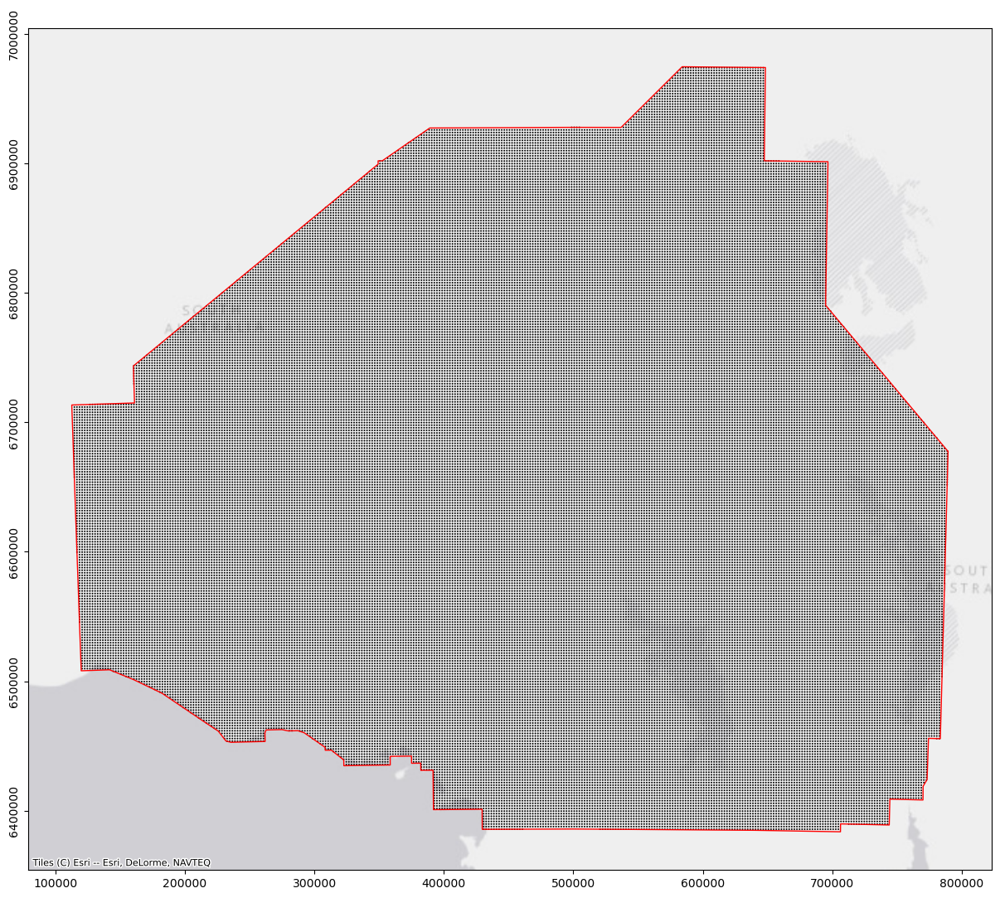

In [6]:
# set the sampling resolution in meter
dist_x, dist_y = (2000, 2000)
x = np.arange(extent[0], extent[1], dist_x)
y = np.arange(extent[2], extent[3], dist_y)
nx = len(x)
ny = len(y)
xs, ys = np.meshgrid(x, y)
xs_flat = xs.flatten()
ys_flat = ys.flatten()

sample_x = []
sample_y = []
sample_mask = []
for xx, yy in zip(xs_flat, ys_flat):
    p = Point((xx, yy))
    if p.within(gc_polygon.geometry[0]):
        sample_x.append(xx)
        sample_y.append(yy)
        sample_mask.append(True)
    else:
        sample_mask.append(False)

sample_coords = pd.DataFrame(sample_x, columns=['X'])
sample_coords['Y'] = sample_y
mask_x = np.array([xs_flat]).T
mask_y = np.array([ys_flat]).T
sample_mask = np.array([sample_mask]).T
mask_coords = np.hstack((mask_x, mask_y, sample_mask))

print('Number of samples:', len(sample_x))

mask_2d = np.reshape(sample_mask, (ny, nx))
mask_2d_ud = np.flipud(mask_2d)

fig, ax = plt.subplots(figsize=(15,15))
ax.scatter(sample_x, sample_y, color='black',  edgecolors='none', s=2)
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.show()

### Gray Level Co-occurrence Matrix (GLCM) Filters

In [7]:
# calculate mean and standard deviation in a buffer zone (circle) surrounding each sampling point
# the raster data frame and the frame used to generate sampling points must be the same
def get_mean_std(xs, ys, raster, bounds, radius):
    points = [Point(x, y) for x, y in zip(xs, ys)]
    means = []
    stds = []
    
    for point in tqdm(points):
        x = point.x
        y = point.y
        xx = []
        yy = []
        
        # prevent nan values
        if x < bounds[0]:
            x = bounds[0]
        if x > bounds[2]:
            x = bounds[2]
        if y < bounds[1]:
            y = bounds[1]
        if y > bounds[3]:
            y = bounds[3]

        x_origin = math.floor((x-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        y_origin = math.floor((y-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))

        radius = math.ceil(radius*raster.shape[1]/(bounds[2]-bounds[0]))
        points_circle = []

        for xr in range(-radius, radius+1):
            Y = int((radius*radius-xr*xr)**0.5)
            for yr in range(-Y, Y+1):
                xc = xr + x_origin
                yc = yr + y_origin
                if xc >= 0 and xc <= raster.shape[1]-1 and yc >= 0 and yc <= raster.shape[0]-1:
                    points_circle.append((xc, yc))

        for p in points_circle:
            xx.append(p[0])
            yy.append(raster.shape[0]-1-p[1])
        
        means.append(np.nanmean(raster[yy, xx]))
        stds.append(np.nanstd(raster[yy, xx]))

    return means, stds

# glcm texture features in a window (square) surrounding each sampling point
def get_glcm(xs, ys, raster, bounds, patch_size):
    points = [Point(x, y) for x, y in zip(xs, ys)]
    dissimilarity = []
    correlation = []
    
    for point in tqdm(points):
        x = point.x
        y = point.y
        
        left = max(x-patch_size/2, bounds[0])
        right = min(x+patch_size/2, bounds[2])
        top = min(y+patch_size/2, bounds[3])
        bottom = max(y-patch_size/2, bounds[1])
        
        left_idx = math.floor((left-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        right_idx = math.floor((right-bounds[0])/(bounds[2]-bounds[0])*(raster.shape[1]-1))
        bottom_idx = math.floor((bottom-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))
        top_idx = math.floor((top-bounds[1])/(bounds[3]-bounds[1])*(raster.shape[0]-1))

        xs = np.arange(left_idx, right_idx+1)
        ys = np.arange(raster.shape[0]-1-top_idx, raster.shape[0]-1-bottom_idx+1)
        xm, ym = np.meshgrid(xs, ys)
        
        if np.isnan(raster[ym, xm]).all():
            dissimilarity.append(np.nan)
            correlation.append(np.nan)
        else:
            raster_scaled = exposure.rescale_intensity(raster[ym, xm], in_range=(np.nanmin(raster[ym, xm]), np.nanmax(raster[ym, xm])), out_range=(0, 1))
            raster_ubyte = util.img_as_ubyte(raster_scaled)
            glcm = graycomatrix(raster_ubyte, distances=[5], angles=[0], levels=256, symmetric=True, normed=True)
            dissimilarity.append(graycoprops(glcm, 'dissimilarity')[0, 0])
            correlation.append(graycoprops(glcm, 'correlation')[0, 0])
    
    return dissimilarity, correlation


In [8]:
### Cell Size

In [9]:
x0 = lons_2d[0, 0]
xr = lons_2d[0, 1]
xd = lons_2d[1, 0]

y0 = lats_2d[0, 0]
yr = lats_2d[0, 1]
yd = lats_2d[1, 0]

size_x = math.sqrt(((xr-x0)**2)+((yr-y0)**2))
size_y = math.sqrt(((xd-x0)**2)+((yd-y0)**2))

print('Cell Size (X): ', size_x)
print('Cell Size (Y): ', size_y)

Cell Size (X):  100.11401376192225
Cell Size (Y):  100.11401376128197


## Export Function

In [10]:
# export an array to a GeoTIFF file
def save_tiff(array, filename):
    dist_x = size_x
    dist_y = size_y
    geotransform = (extent[0], dist_x, 0, extent[3], 0, -dist_y)
    map_file = f'./Datasets/Gravity/New/{filename}.tiff'
    driver = gdal.GetDriverByName('GTiff')
    nx = array.shape[1]
    ny = array.shape[0]
    dataset = driver.Create(map_file, nx, ny, 1, gdal.GDT_Float32)
    dataset.SetGeoTransform(geotransform)
    srs = osr.SpatialReference()
    srs.ImportFromEPSG(7853)
    dataset.SetProjection(srs.ExportToWkt())
    dataset.GetRasterBand(1).WriteArray(array)
    dataset.FlushCache()
    dataset = None

## Import filters

In [11]:
# import filters
sys.path.append('codes/')
from codes import derivative, auxiliars, filtering

# Processing

## Upward Continuation

In [12]:
### Upward Continuation (500 m)

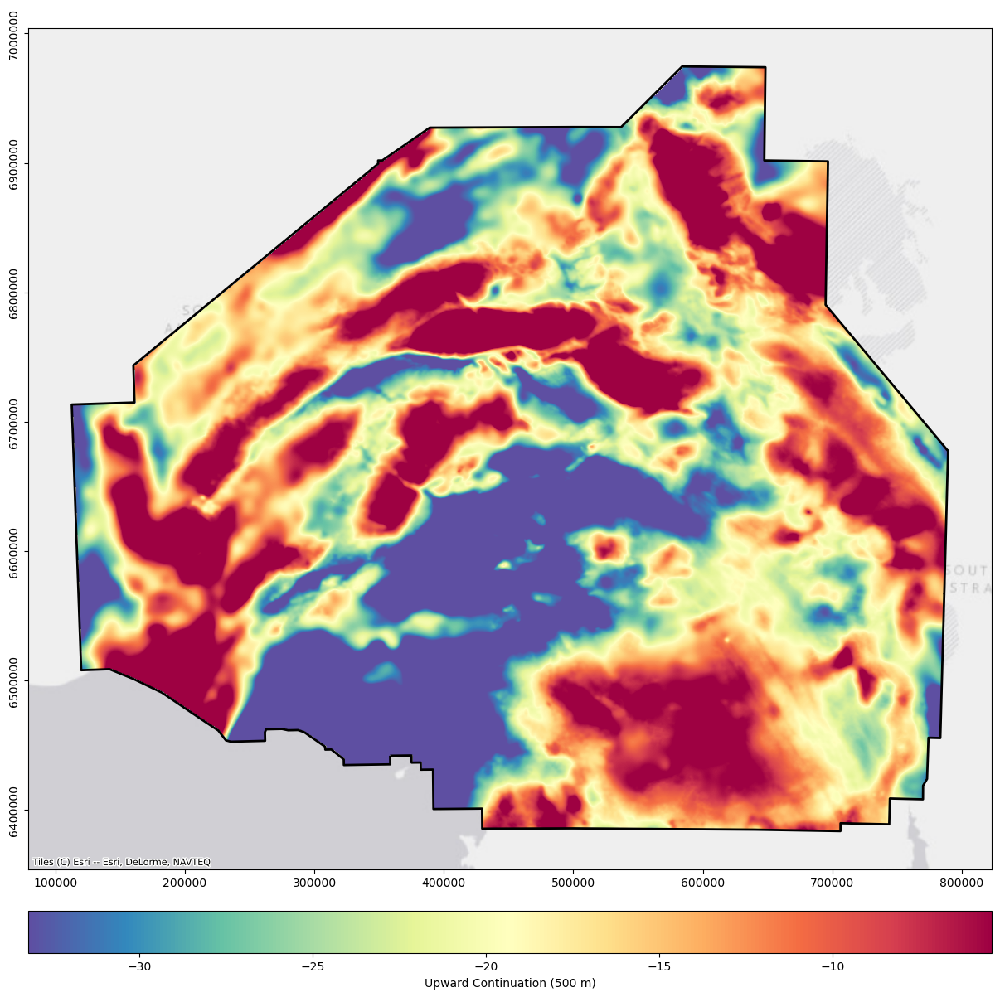

In [13]:
upcont_file = './Datasets/Gravity/New/upcont500.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of the dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont500 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 500)
    upcont_2d = np.reshape(upcont500, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont500')

upcont500 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont500.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values

plot_array_stretched(upcont_clipped_array, 'Upward Continuation (500 m)')

In [14]:
### Upward Continuation (1000 m)

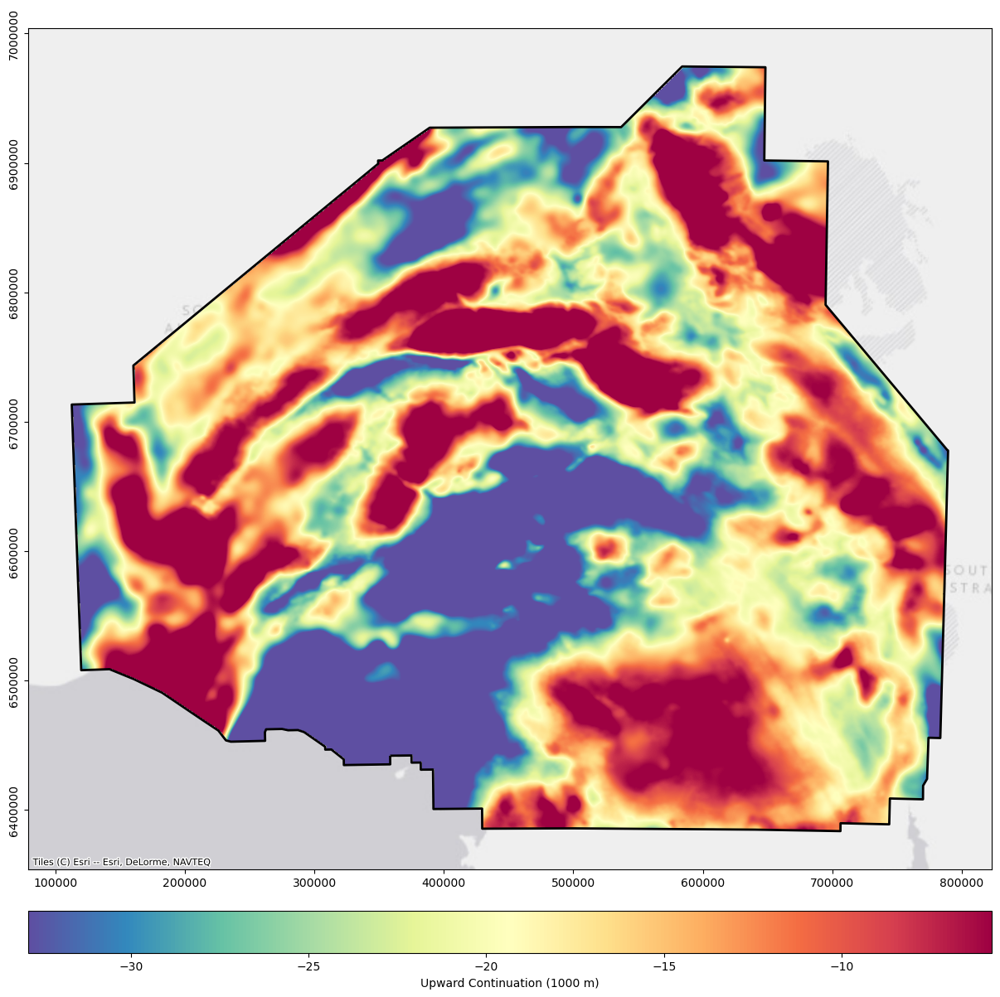

In [15]:
upcont_file = './Datasets/Gravity/New/upcont1000.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont1000 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 1000)
    upcont_2d = np.reshape(upcont1000, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont1000')

upcont1000 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont1000.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values
plot_array_stretched(upcont_clipped_array, 'Upward Continuation (1000 m)')

In [16]:
### Upward Continuation (2000 m)

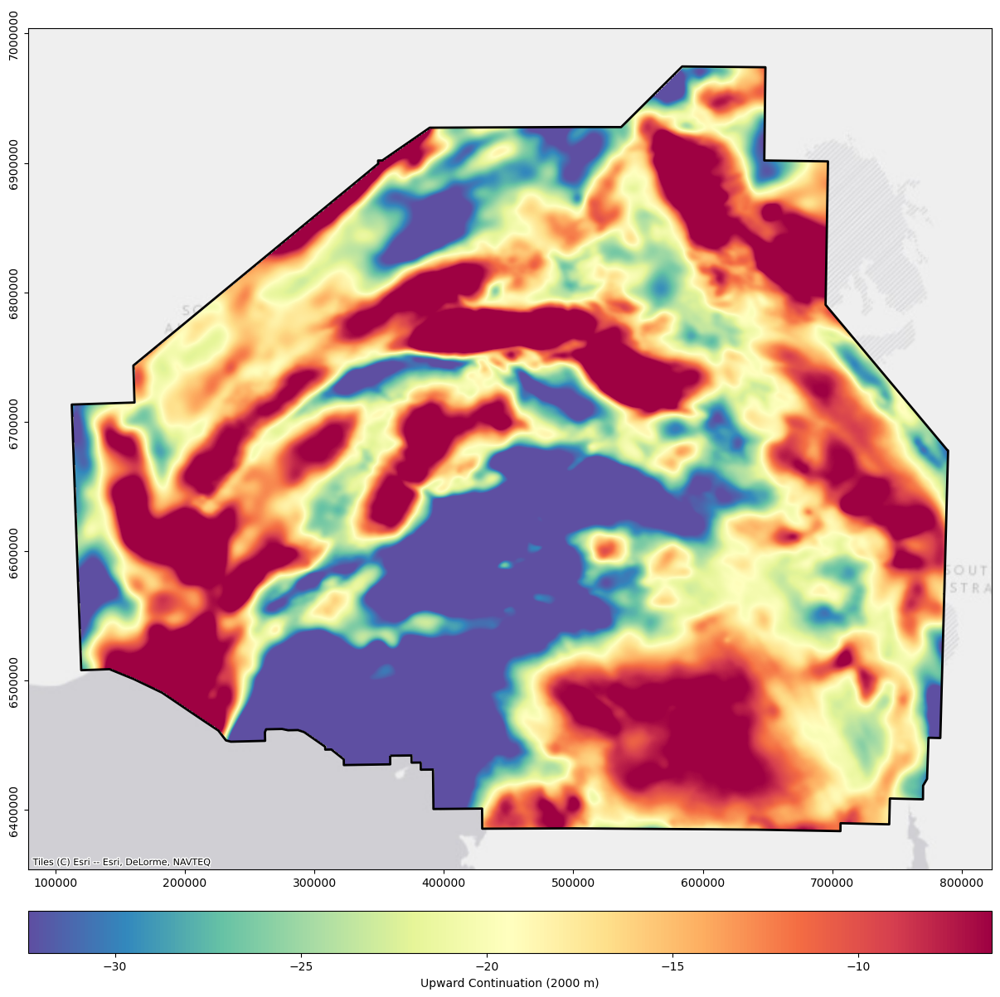

In [17]:
upcont_file = './Datasets/Gravity/New/upcont2000.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont2000 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 2000)
    upcont_2d = np.reshape(upcont2000, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont2000')

upcont2000 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont2000.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values
plot_array_stretched(upcont_clipped_array, 'Upward Continuation (2000 m)')

In [18]:
### Upward Continuation (3000 m)

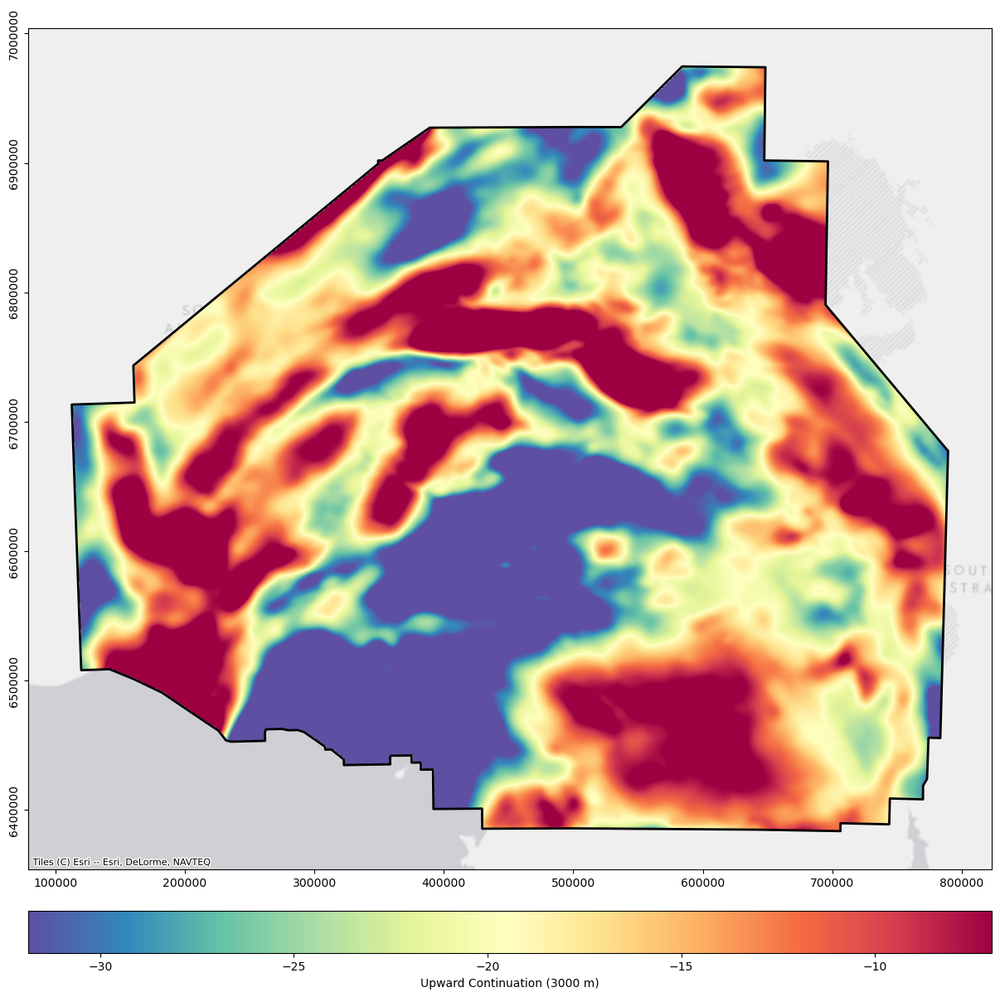

In [19]:
upcont_file = './Datasets/Gravity/New/upcont3000.tiff'

if not os.path.isfile(upcont_file):
    # calculate the upward continuated data
    # returns broad features of dataset
    # removes the effects of very nearby/shallow susceptible material
    # the last number is the new observation level
    upcont3000 = filtering.my_continuation(lons_2d, lats_2d, raster_clipped_array, 3000)
    upcont_2d = np.reshape(upcont3000, np.shape(raster_clipped_array))
    save_tiff(upcont_2d, 'upcont3000')

upcont3000 = rxr.open_rasterio(upcont_file, masked=True).squeeze()
upcont_clipped = upcont3000.rio.clip(gc_polygon.geometry.apply(mapping))
upcont_clipped_array = upcont_clipped.values
plot_array_stretched(upcont_clipped_array, 'Upward Continuation (3000 m)')

## Analytic Signal

In [20]:
### Analytic Signal Upward Continuation (500 m)

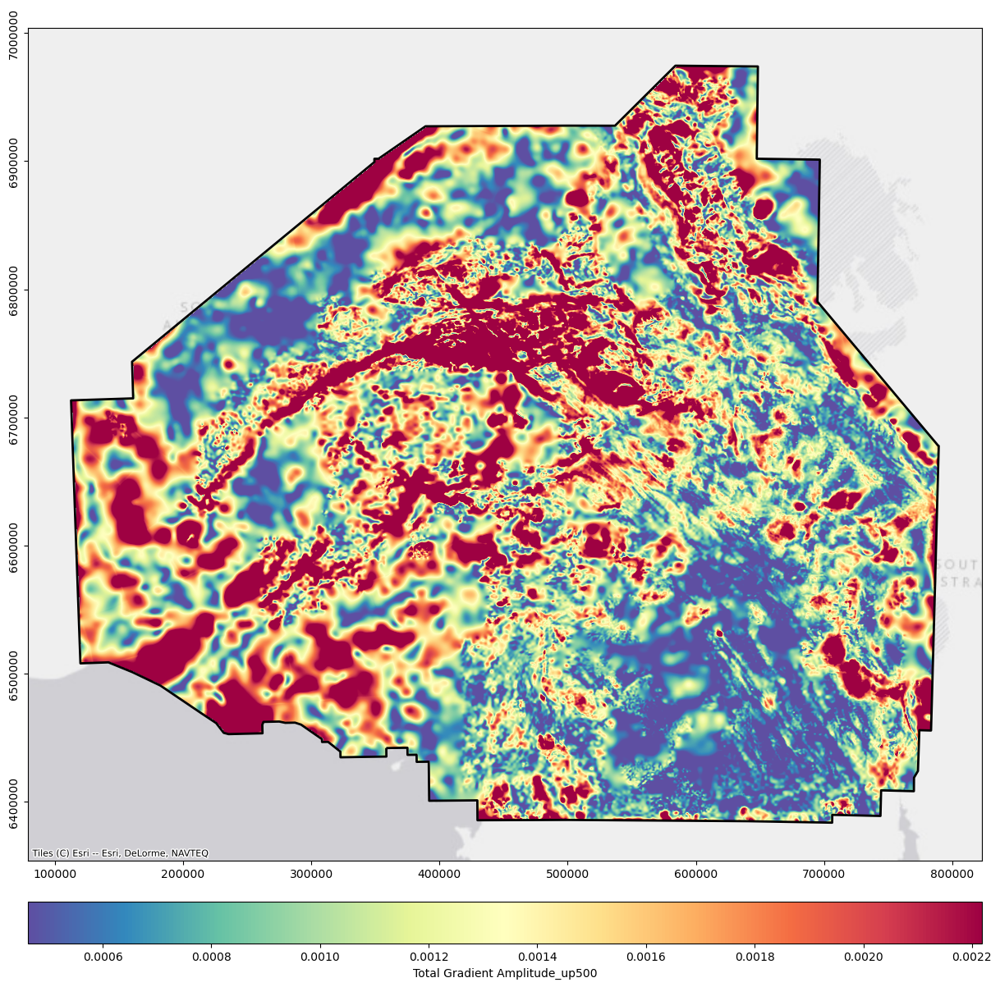

In [21]:
tga_file = './Datasets/Gravity/New/tga_up500.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up500 = derivative.my_totalgrad(lons_2d, lats_2d, upcont500)
    tga_2d = np.reshape(tga_up500, np.shape(upcont500))
    save_tiff(tga_2d, 'tga_up500')

tga_up500 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up500.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up500')

In [22]:
### Analytic Signal Upward Continuation (1000 m)

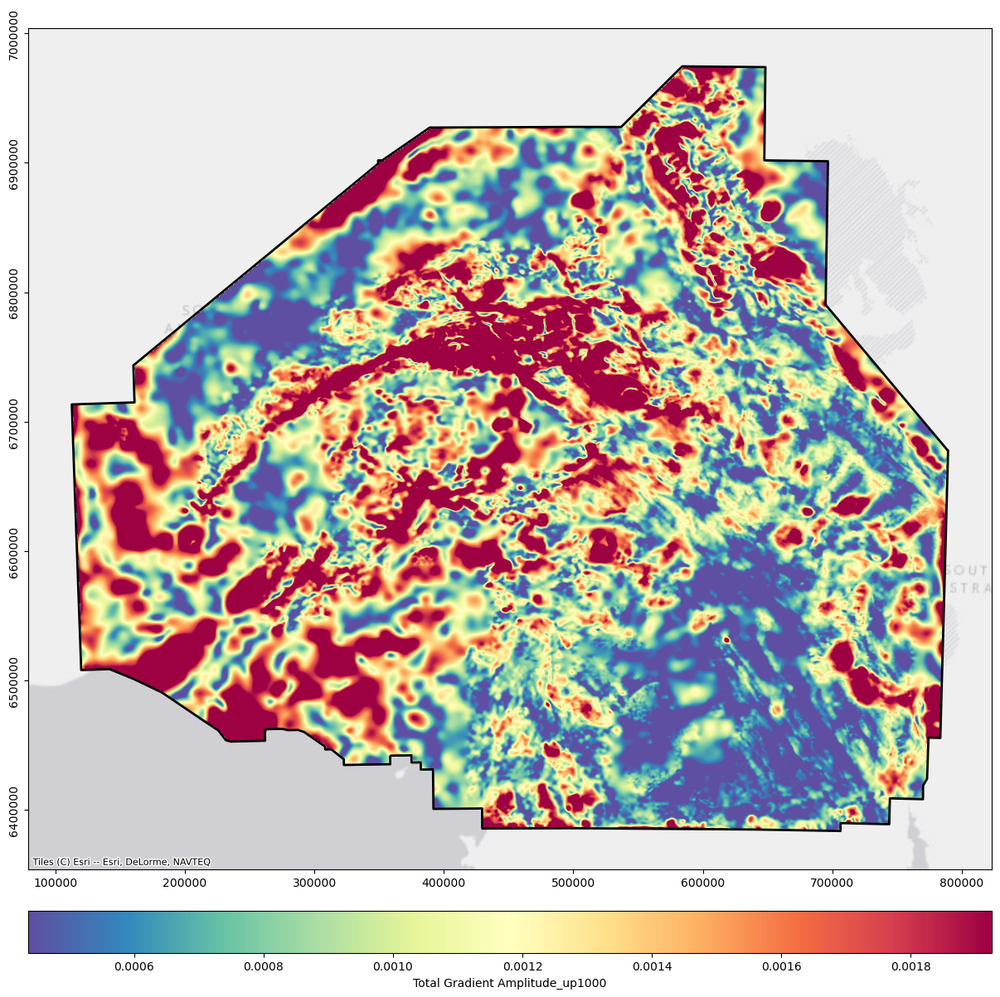

In [23]:
tga_file = './Datasets/Gravity/New/tga_up1000.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up1000 = derivative.my_totalgrad(lons_2d, lats_2d, upcont1000)
    tga_2d = np.reshape(tga_up1000, np.shape(upcont1000))
    save_tiff(tga_2d, 'tga_up1000')

tga_up1000 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up1000')

In [24]:
### Analytic Signal Upward Continuation (2000 m)

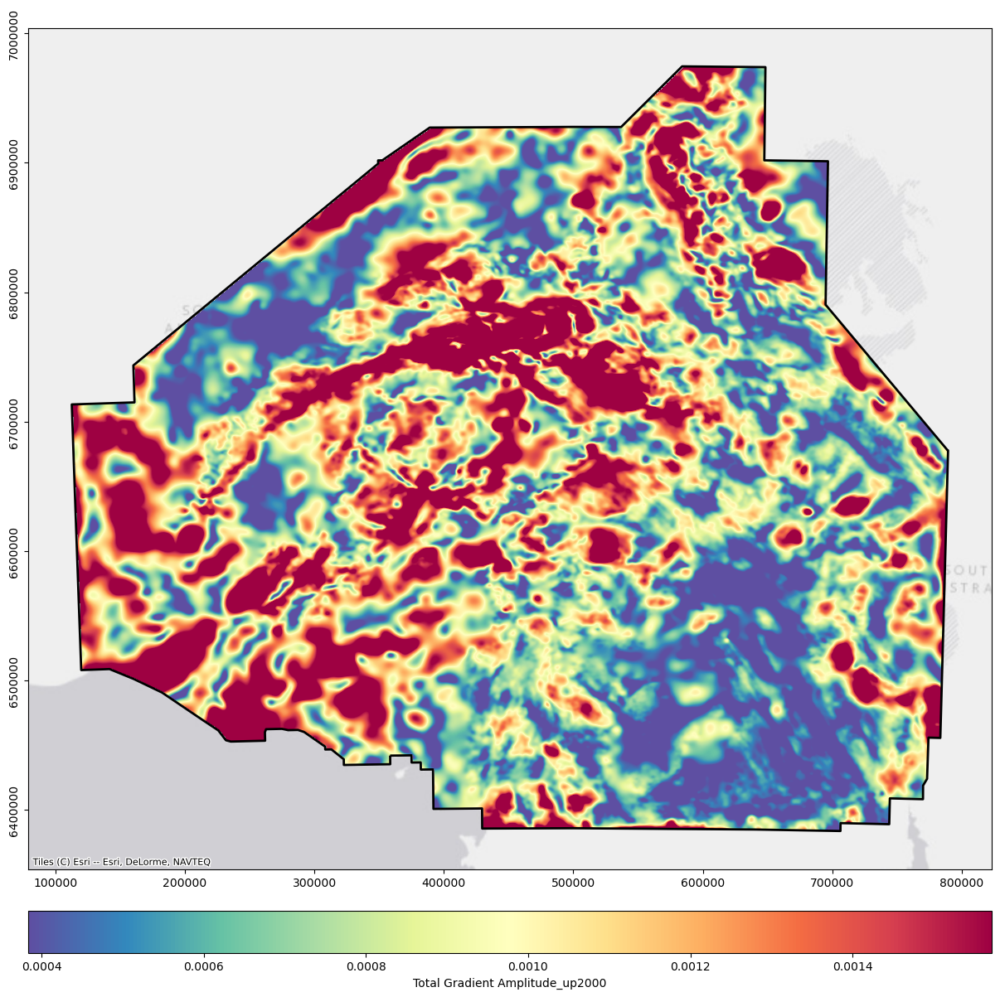

In [25]:
tga_file = './Datasets/Gravity/New/tga_up2000.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up2000 = derivative.my_totalgrad(lons_2d, lats_2d, upcont2000)
    tga_2d = np.reshape(tga_up2000, np.shape(upcont2000))
    save_tiff(tga_2d, 'tga_up2000')

tga_up2000 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up2000')

In [26]:
### Analytic Signal Upward Continuation (3000 m)

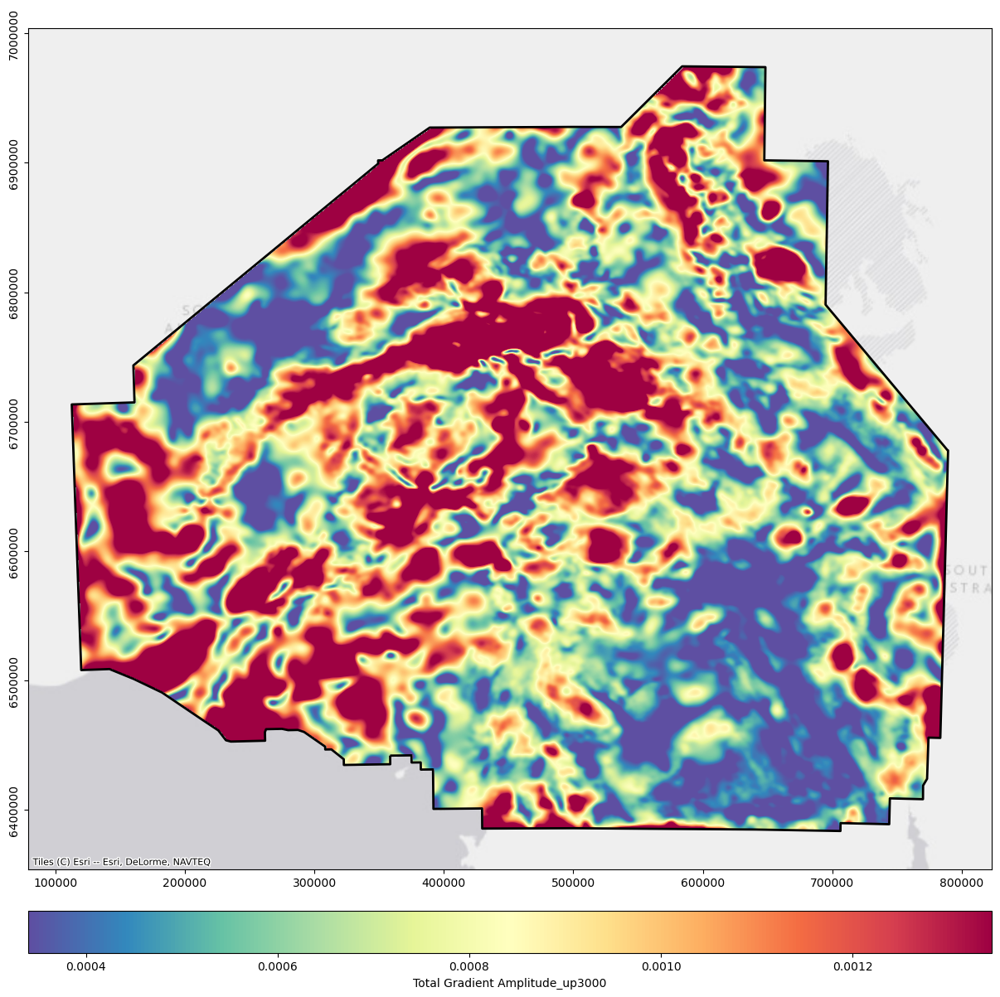

In [27]:
tga_file = './Datasets/Gravity/New/tga_up3000.tiff'

if not os.path.isfile(tga_file):
    # total gradient amplitude (analytic signal)
    tga_up3000 = derivative.my_totalgrad(lons_2d, lats_2d, upcont3000)
    tga_2d = np.reshape(tga_up3000, np.shape(upcont3000))
    save_tiff(tga_2d, 'tga_up3000')

tga_up3000 = rxr.open_rasterio(tga_file, masked=True).squeeze()
tga_clipped = tga_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
tga_clipped_array = tga_clipped.values
plot_array_stretched(tga_clipped_array, 'Total Gradient Amplitude_up3000')

## Horizontal Derivatives (X)

In [28]:
#Horizontal Derivatives (X) Upward Continuation (500 m)

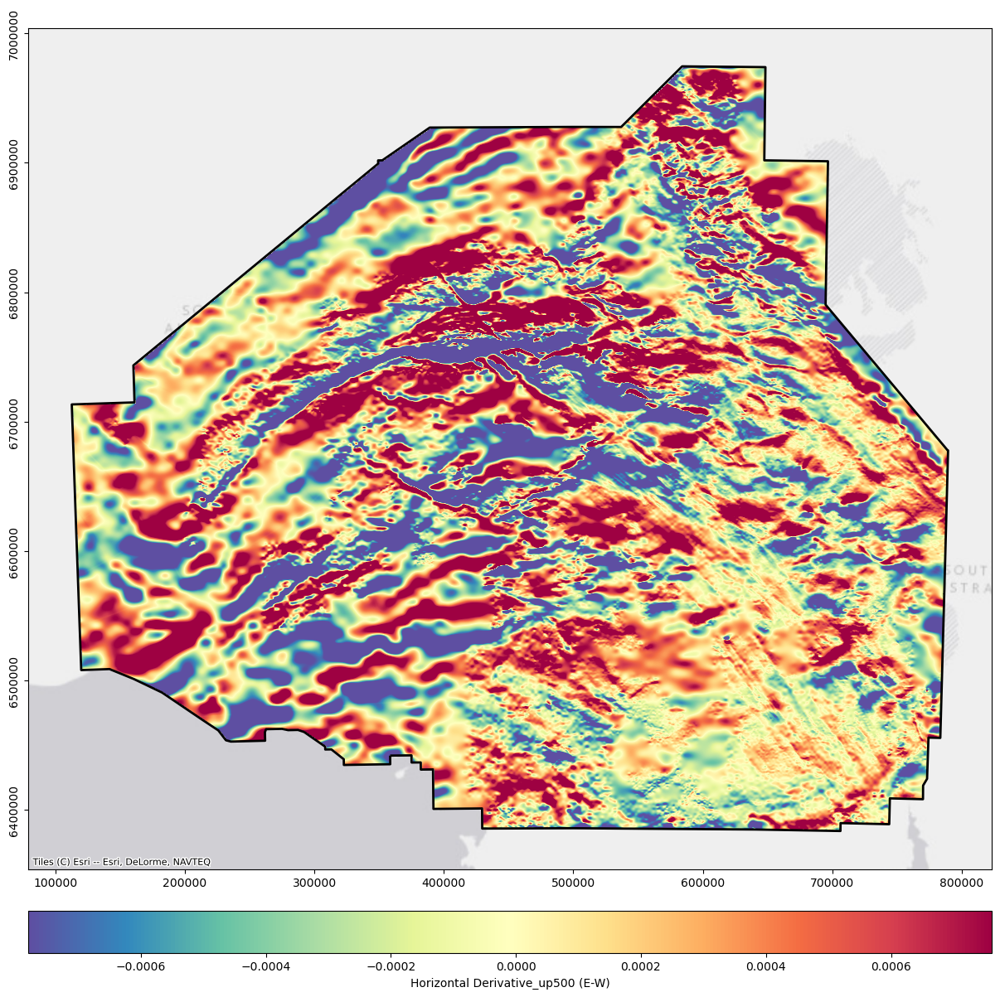

In [29]:
deriv_x_file = './Datasets/Gravity/New/deriv_x_up500.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up500 = derivative.my_xderiv(lons_2d, lats_2d, upcont500, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up500, np.shape(upcont500))
    save_tiff(derivx_2d, 'deriv_x_up500')

deriv_x_up500 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up500.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative_up500 (E-W)')

In [30]:
#Horizontal Derivatives (X) Upward Continuation (1000 m)

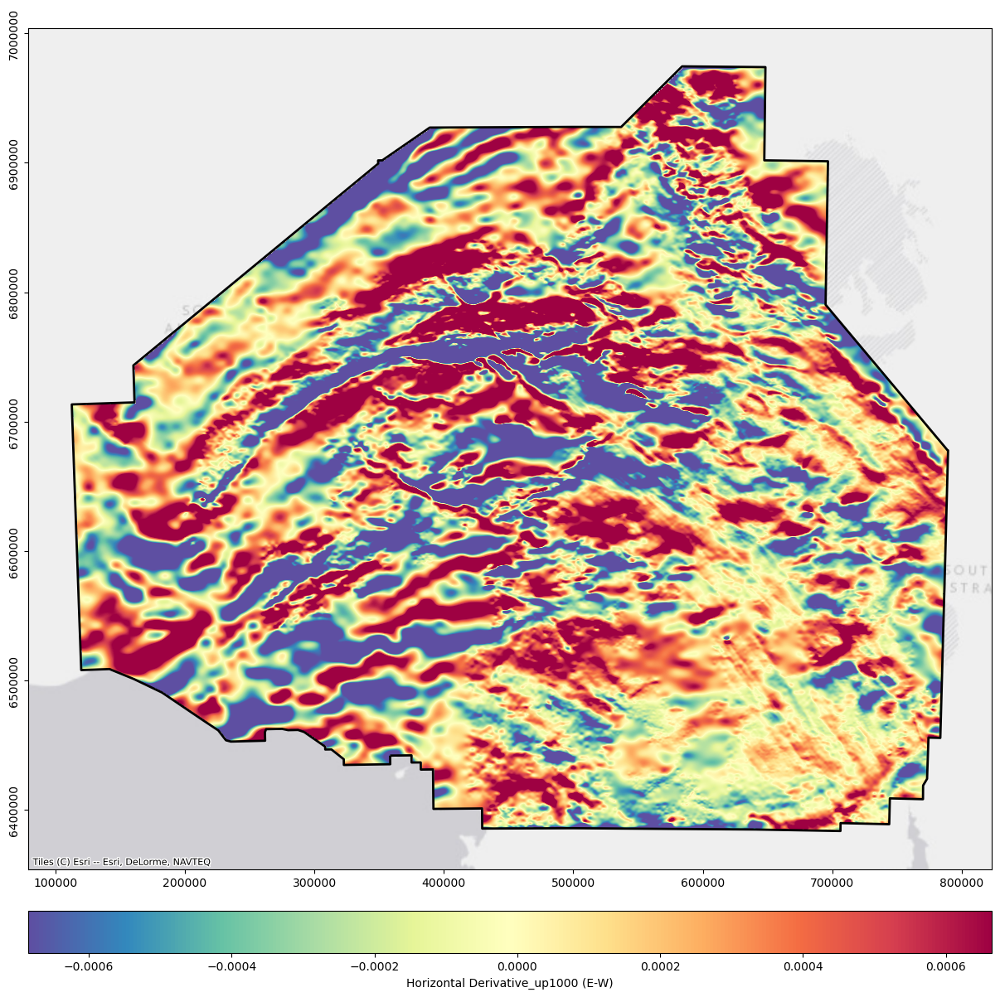

In [31]:
deriv_x_file = './Datasets/Gravity/New/deriv_x_up1000.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up1000 = derivative.my_xderiv(lons_2d, lats_2d, upcont1000, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up1000, np.shape(upcont1000))
    save_tiff(derivx_2d, 'deriv_x_up1000')

deriv_x_up1000 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative_up1000 (E-W)')

In [32]:
#Horizontal Derivatives (X) Upward Continuation (2000 m)

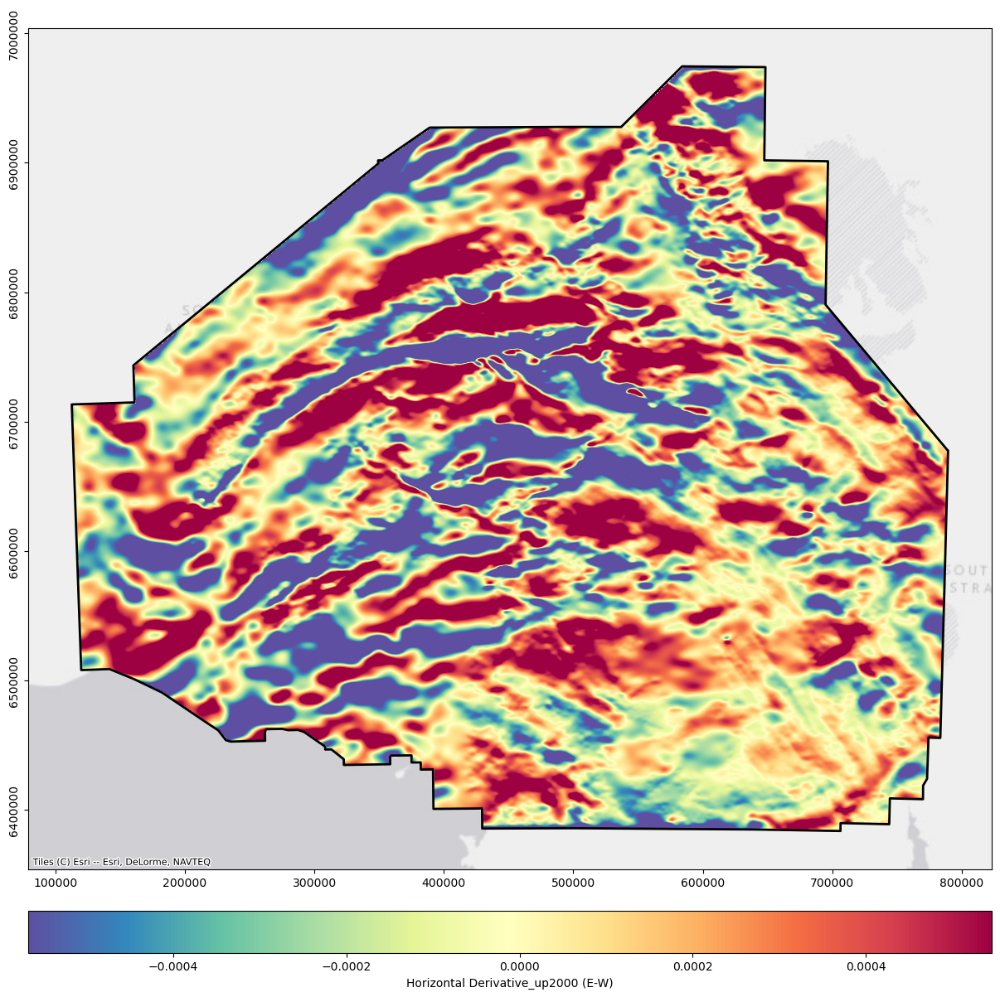

In [33]:
deriv_x_file = './Datasets/Gravity/New/deriv_x_up2000.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up2000 = derivative.my_xderiv(lons_2d, lats_2d, upcont2000, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up2000, np.shape(upcont2000))
    save_tiff(derivx_2d, 'deriv_x_up2000')

deriv_x_up2000 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative_up2000 (E-W)')

In [34]:
#Horizontal Derivatives (X) Upward Continuation (3000 m)

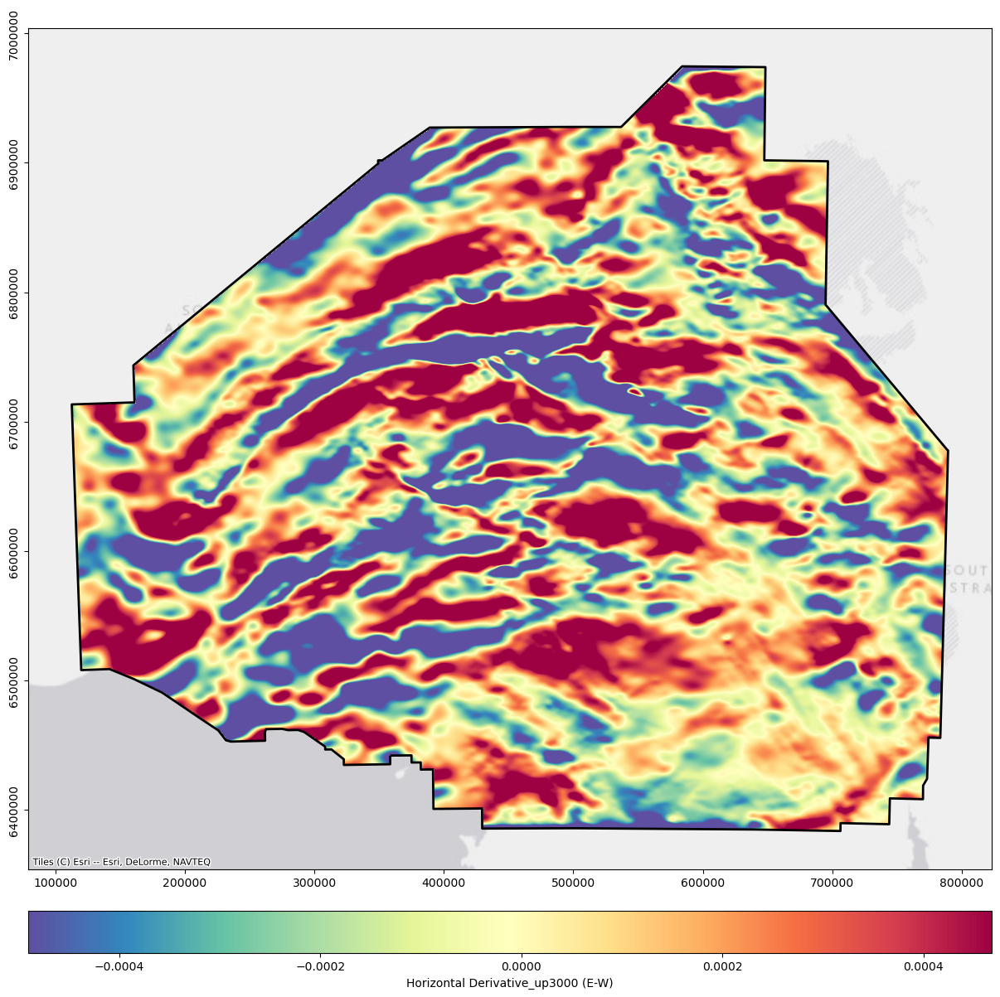

In [35]:
deriv_x_file = './Datasets/Gravity/New/deriv_x_up3000.tiff'

if not os.path.isfile(deriv_x_file):
    # calculate the first order horizontal derivative in X direction
    derivx_up3000 = derivative.my_xderiv(lons_2d, lats_2d, upcont3000, n=1) # n = order of the derivative
    derivx_2d = np.reshape(derivx_up3000, np.shape(upcont3000))
    save_tiff(derivx_2d, 'deriv_x_up3000')

deriv_x_up3000 = rxr.open_rasterio(deriv_x_file, masked=True).squeeze()
deriv_x_clipped = deriv_x_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_x_clipped_array = deriv_x_clipped.values
plot_array_stretched(deriv_x_clipped_array, 'Horizontal Derivative_up3000 (E-W)')

## Horizontal Derivatives (Y)

In [36]:
#Horizontal Derivatives (Y) Upward Continuation (500 m)

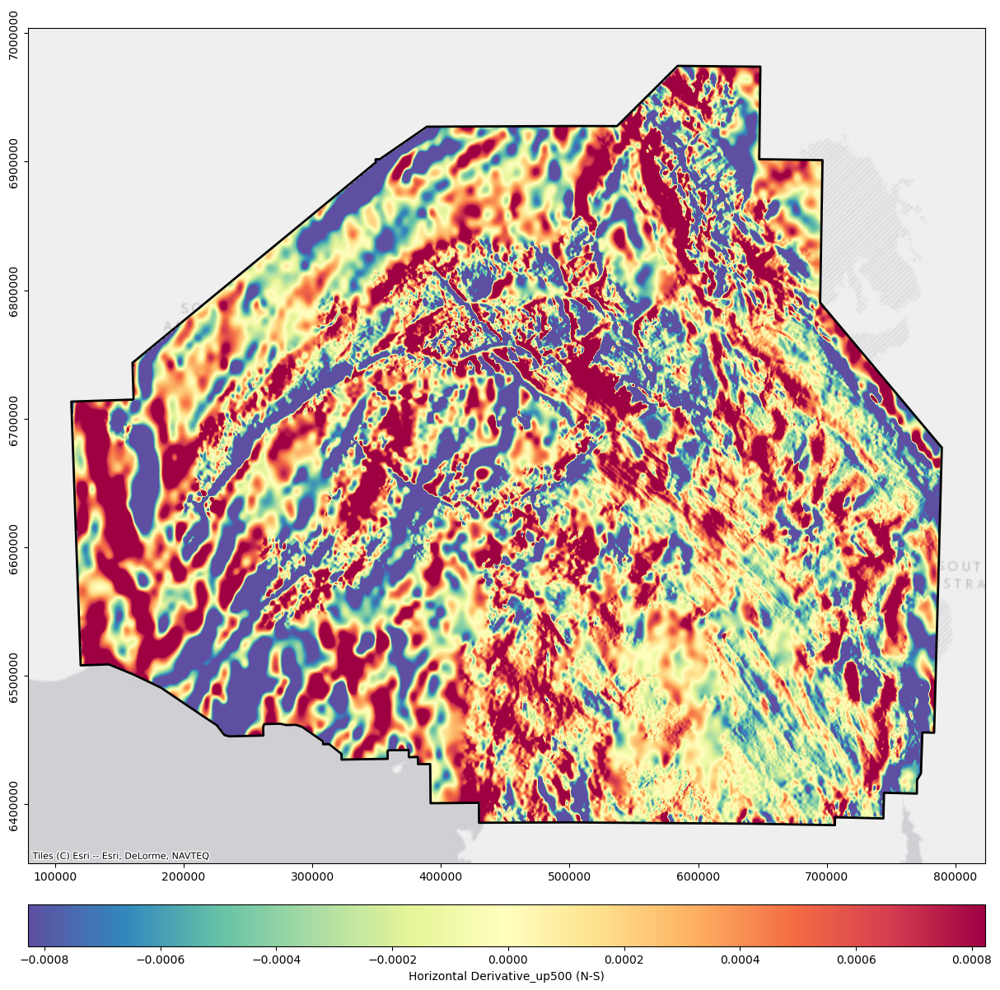

In [37]:
deriv_y_file = './Datasets/Gravity/New/deriv_y_up500.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up500 = derivative.my_yderiv(lons_2d, lats_2d, upcont500, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up500, np.shape(upcont500))
    save_tiff(derivy_2d, 'deriv_y_up500')

deriv_y_up500 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up500.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative_up500 (N-S)')

In [38]:
#Horizontal Derivatives (Y) Upward Continuation (1000 m)

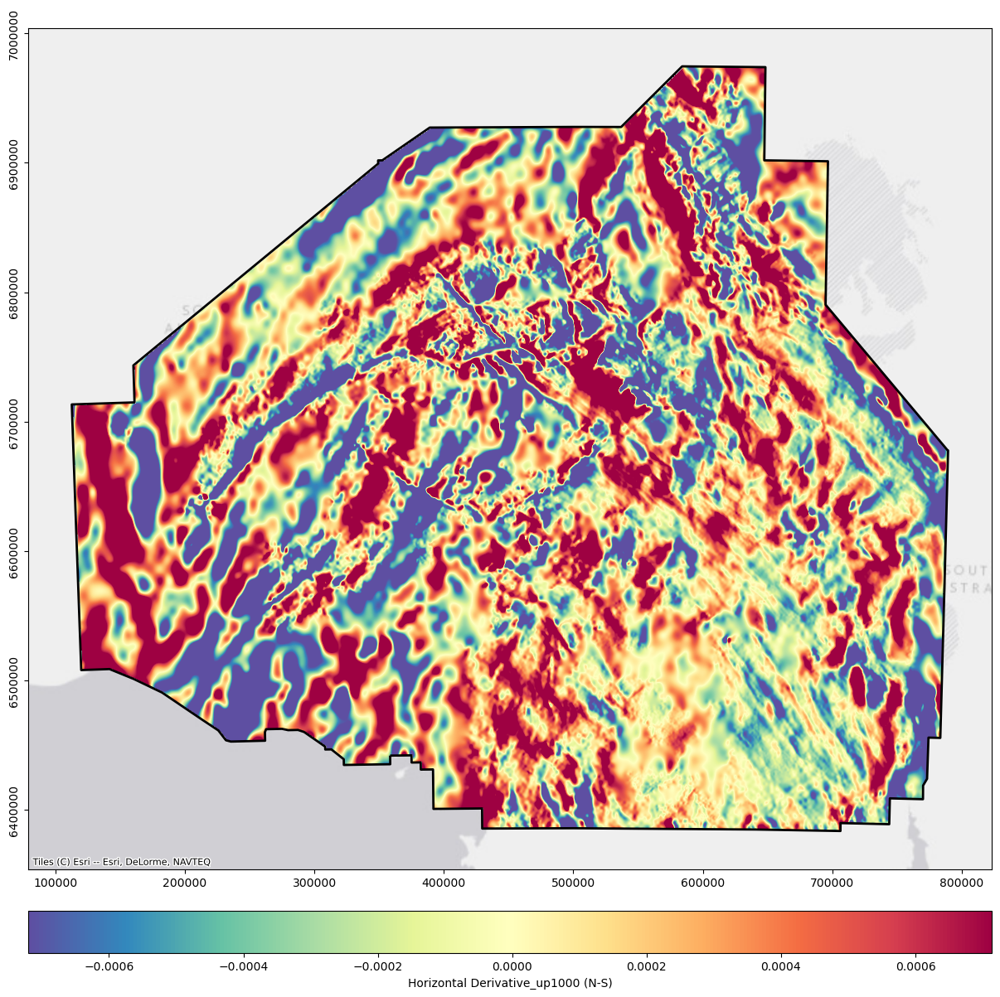

In [39]:
deriv_y_file = './Datasets/Gravity/New/deriv_y_up1000.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up1000 = derivative.my_yderiv(lons_2d, lats_2d, upcont1000, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up1000, np.shape(upcont1000))
    save_tiff(derivy_2d, 'deriv_y_up1000')

deriv_y_up1000 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative_up1000 (N-S)')

In [40]:
#Horizontal Derivatives (Y) Upward Continuation (2000 m)

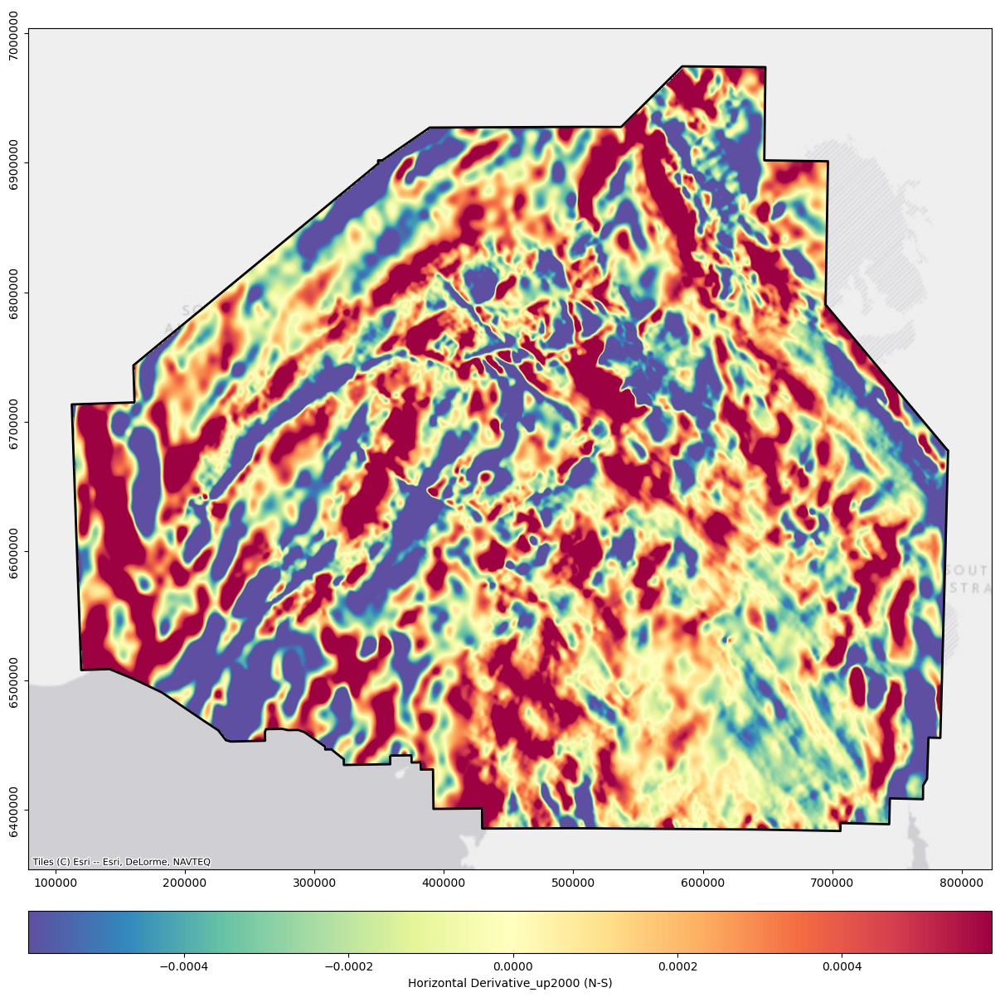

In [41]:
deriv_y_file = './Datasets/Gravity/New/deriv_y_up2000.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up2000 = derivative.my_yderiv(lons_2d, lats_2d, upcont2000, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up2000, np.shape(upcont2000))
    save_tiff(derivy_2d, 'deriv_y_up2000')

deriv_y_up2000 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative_up2000 (N-S)')

In [42]:
#Horizontal Derivatives (Y) Upward Continuation (3000 m)

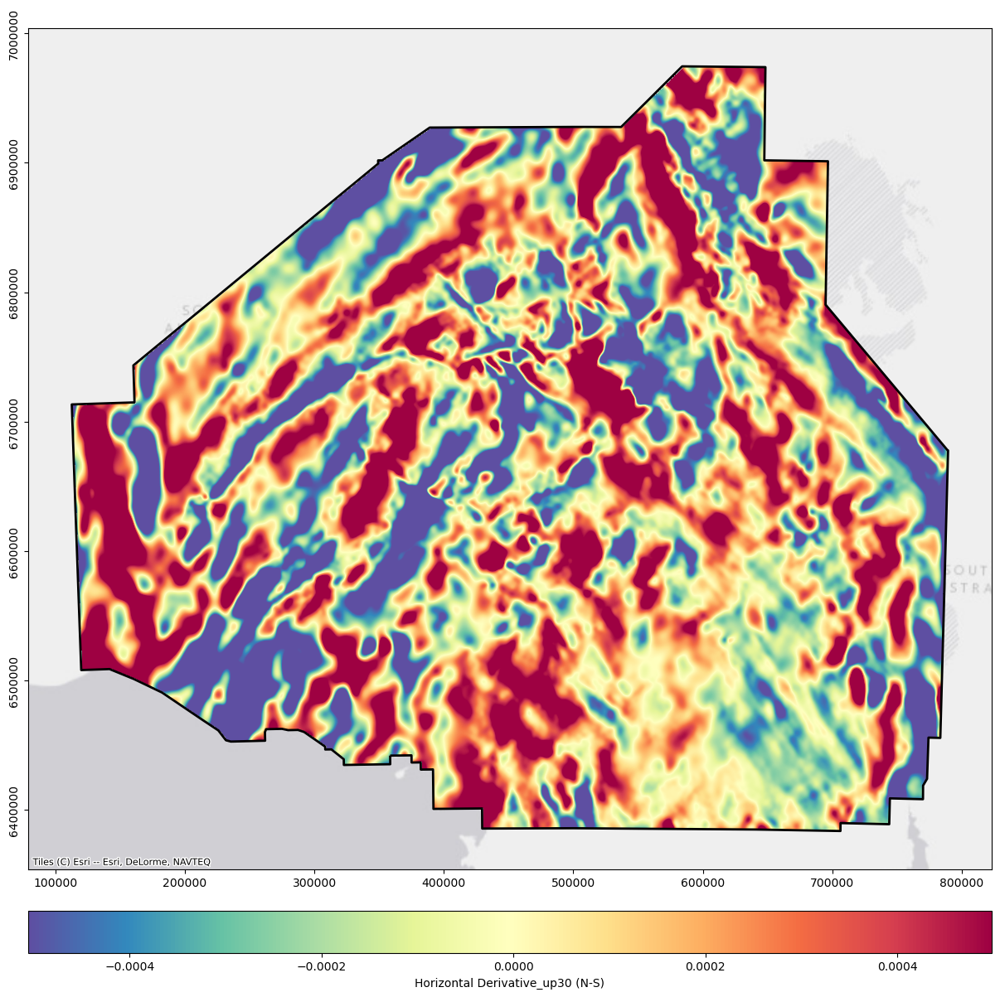

In [43]:
deriv_y_file = './Datasets/Gravity/New/deriv_y_up3000.tiff'

if not os.path.isfile(deriv_y_file):
    # calculate the first order horizontal derivative in Y direction
    derivy_up3000 = derivative.my_yderiv(lons_2d, lats_2d, upcont3000, n=1) # n = order of the derivative
    derivy_2d = np.reshape(derivy_up3000, np.shape(upcont3000))
    save_tiff(derivy_2d, 'deriv_y_up3000')

deriv_y_up3000 = rxr.open_rasterio(deriv_y_file, masked=True).squeeze()
deriv_y_clipped = deriv_y_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
deriv_y_clipped_array = deriv_y_clipped.values
plot_array_stretched(deriv_y_clipped_array, 'Horizontal Derivative_up30 (N-S)')

## Horizontal Derivatives (Gradient Amplitude)

In [44]:
# Horizontal Derivatives (Gradient Amplitude) Upward Continuation (500 m)

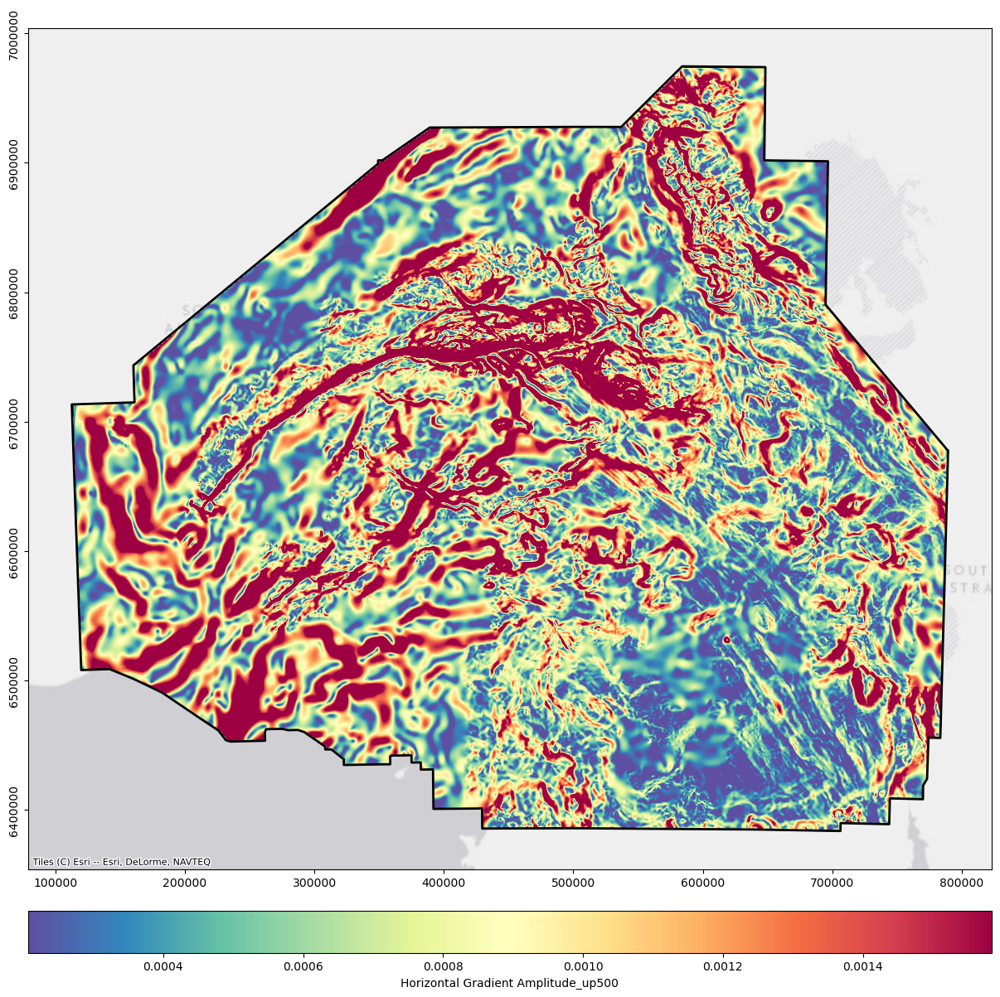

In [45]:
hga_file = './Datasets/Gravity/New/hga_up500.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up500 = derivative.my_hgrad(lons_2d, lats_2d, upcont500)
    hga_2d = np.reshape(hga_up500, np.shape(upcont500))
    save_tiff(hga_2d, 'hga_up500')

hga_up500 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up500.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up500')

In [46]:
# Horizontal Derivatives (Gradient Amplitude) Upward Continuation (1000 m)

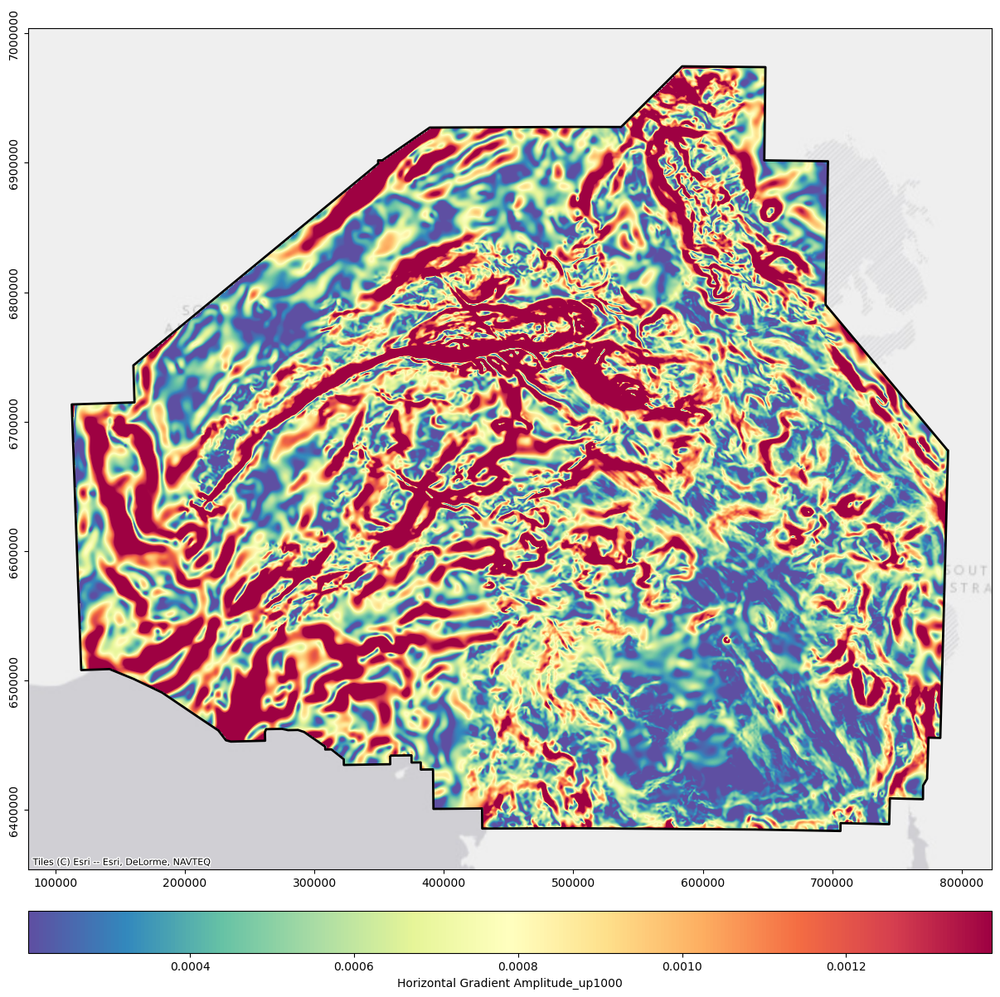

In [47]:
hga_file = './Datasets/Gravity/New/hga_up1000.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up1000 = derivative.my_hgrad(lons_2d, lats_2d, upcont1000)
    hga_2d = np.reshape(hga_up1000, np.shape(upcont1000))
    save_tiff(hga_2d, 'hga_up1000')

hga_up1000 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up1000')

In [48]:
# Horizontal Derivatives (Gradient Amplitude) Upward Continuation (2000 m)

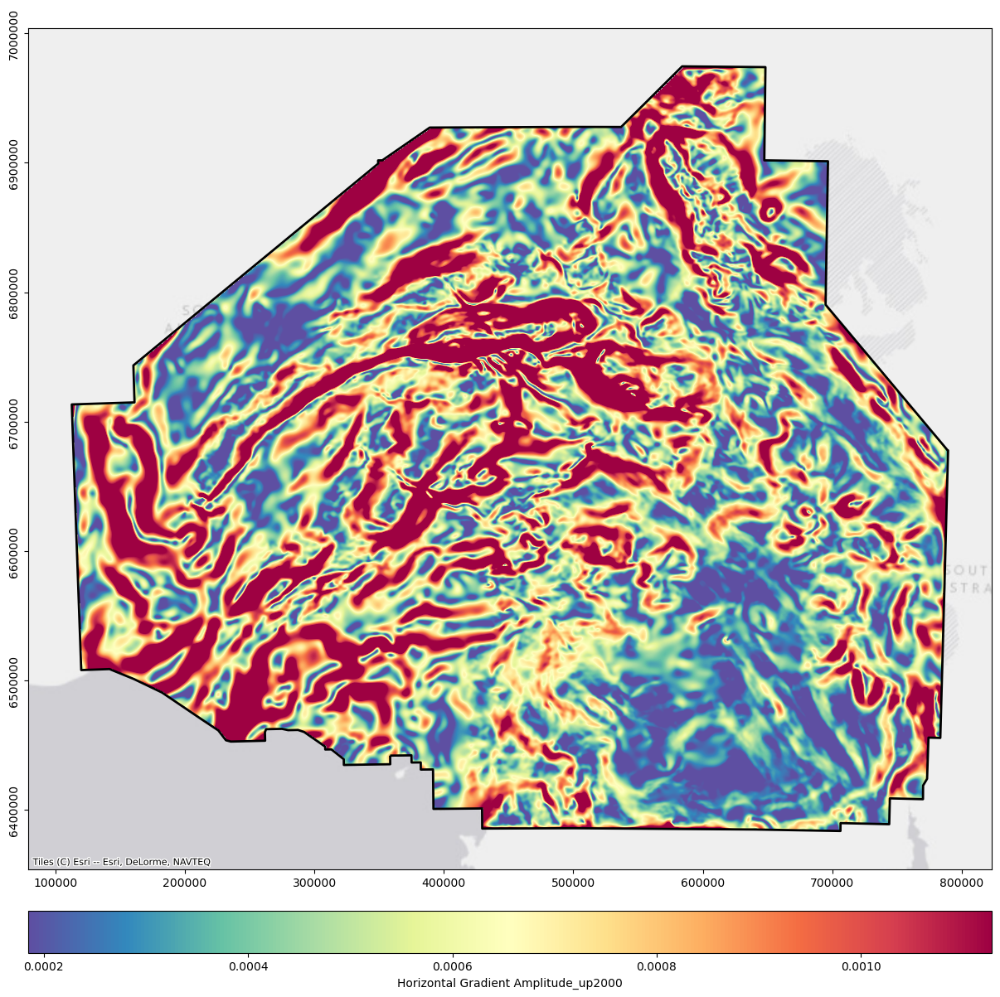

In [49]:
hga_file = './Datasets/Gravity/New/hga_up2000.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up2000 = derivative.my_hgrad(lons_2d, lats_2d, upcont2000)
    hga_2d = np.reshape(hga_up2000, np.shape(upcont2000))
    save_tiff(hga_2d, 'hga_up2000')

hga_up2000 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up2000')

In [50]:
# Horizontal Derivatives (Gradient Amplitude) Upward Continuation (3000 m)

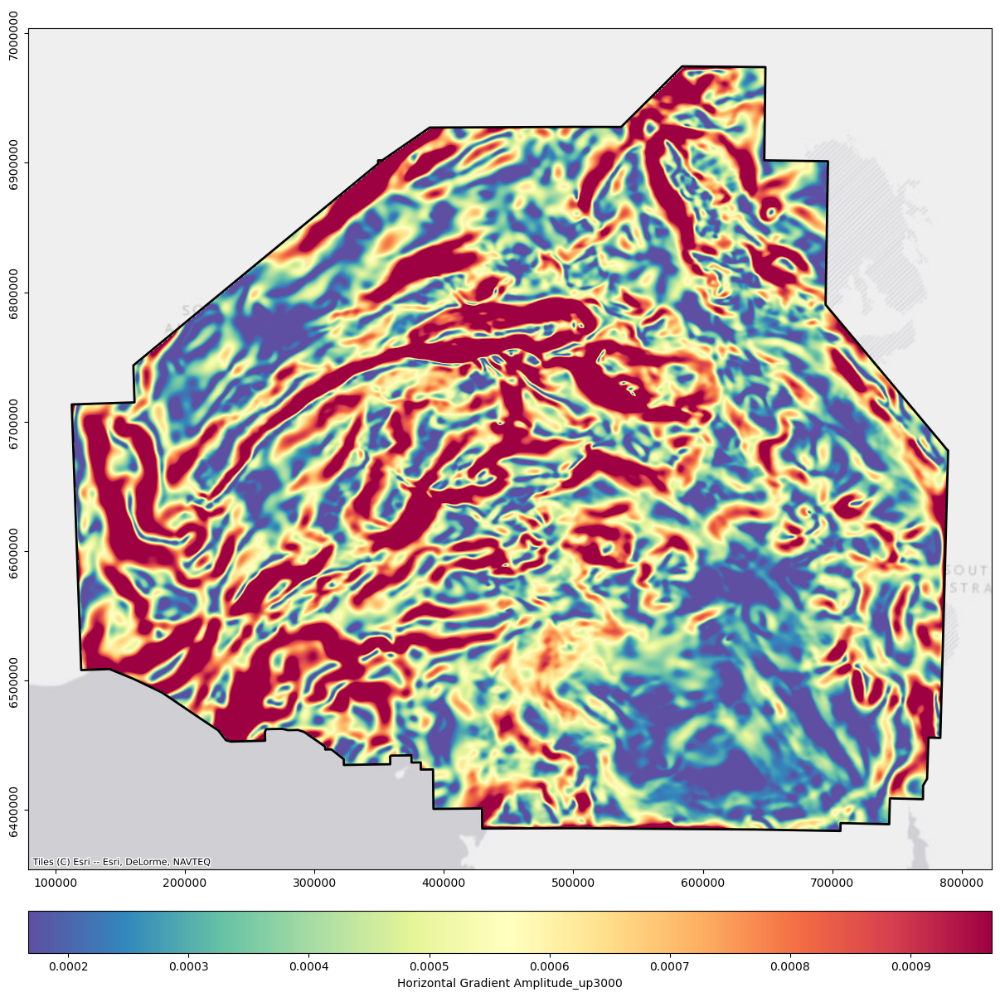

In [51]:
hga_file = './Datasets/Gravity/New/hga_up3000.tiff'

if not os.path.isfile(hga_file):
    # calculate the horizontal gradient amplitude
    hga_up3000 = derivative.my_hgrad(lons_2d, lats_2d, upcont3000)
    hga_2d = np.reshape(hga_up3000, np.shape(upcont3000))
    save_tiff(hga_2d, 'hga_up3000')

hga_up3000 = rxr.open_rasterio(hga_file, masked=True).squeeze()
hga_clipped = hga_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
hga_clipped_array = hga_clipped.values
plot_array_stretched(hga_clipped_array, 'Horizontal Gradient Amplitude_up3000')

## Tilt Angle

In [52]:
### Tilt Angle Upward Continuation (500 m)

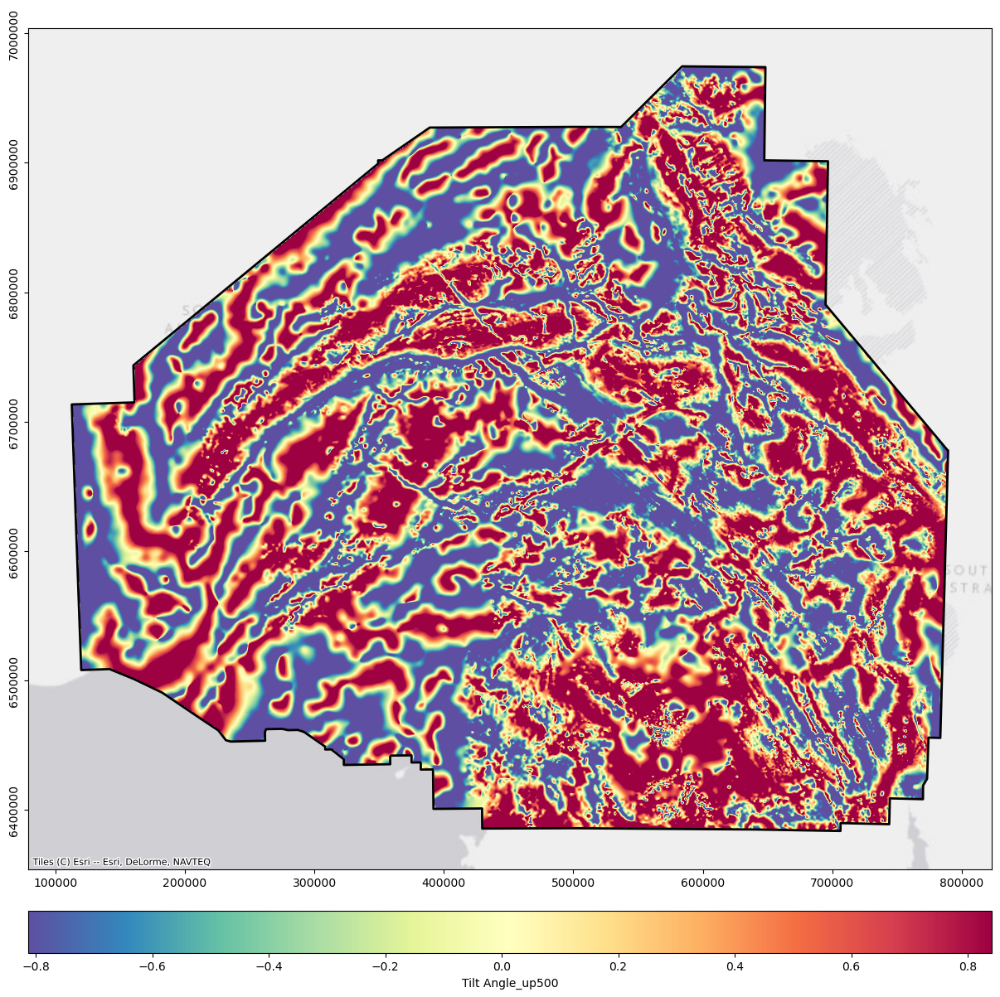

In [53]:
tilt_angle_file = './Datasets/Gravity/New/tilt_angle_up500.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up500 = filtering.my_tilt(lons_2d, lats_2d, upcont500)
    tilt_angle_2d = np.reshape(tilt_angle_up500, np.shape(upcont500))
    save_tiff(tilt_angle_2d, 'tilt_angle_up500')

tilt_angle_up500 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up500.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up500')

In [54]:
### Tilt Angle Upward Continuation (1000 m)

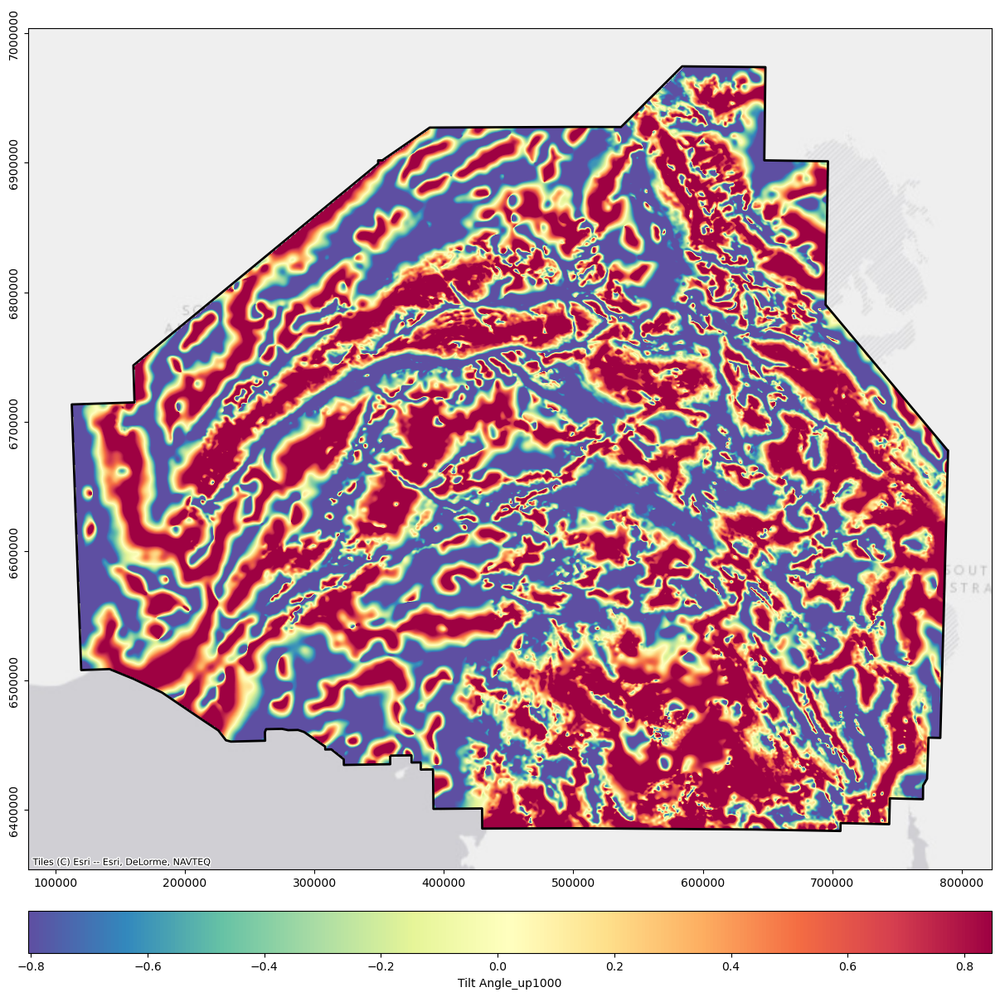

In [55]:
tilt_angle_file = './Datasets/Gravity/New/tilt_angle_up1000.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up1000 = filtering.my_tilt(lons_2d, lats_2d, upcont1000)
    tilt_angle_2d = np.reshape(tilt_angle_up1000, np.shape(upcont1000))
    save_tiff(tilt_angle_2d, 'tilt_angle_up1000')

tilt_angle_up1000 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up1000')

In [56]:
### Tilt Angle Upward Continuation (2000 m)

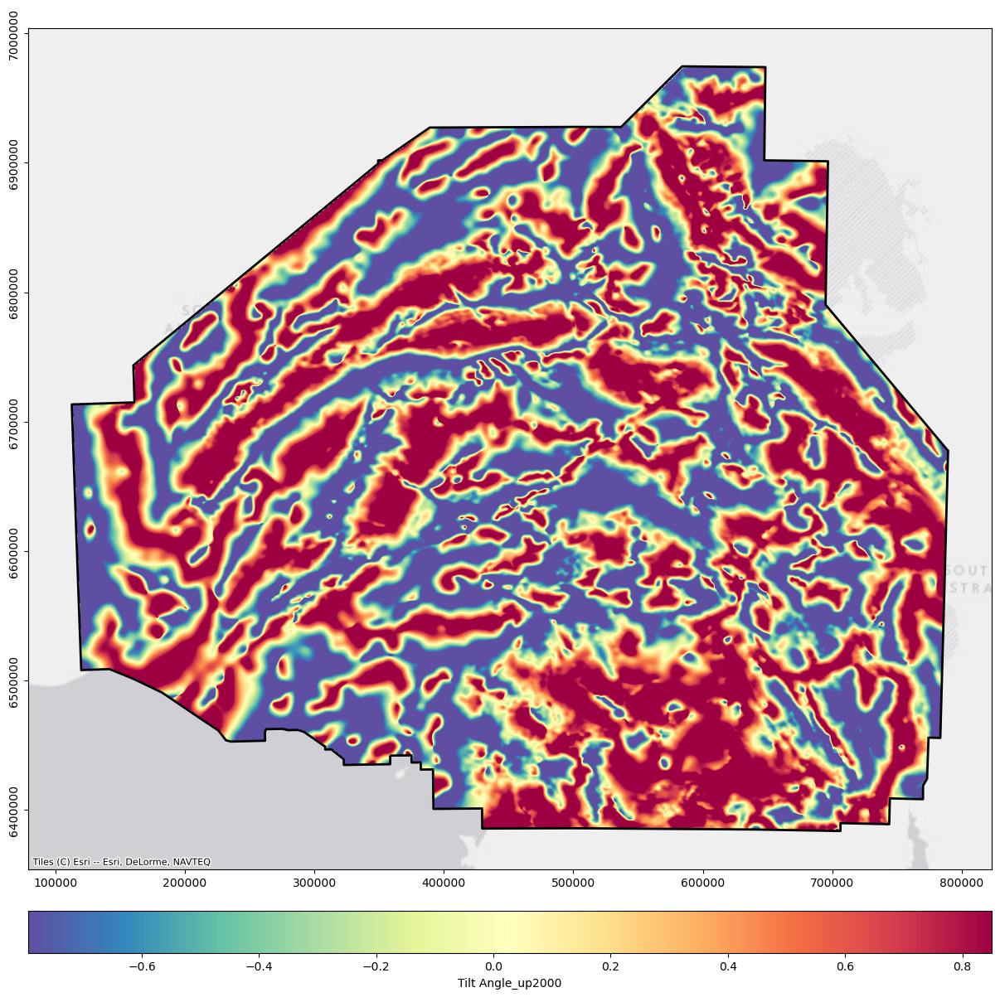

In [57]:
tilt_angle_file = './Datasets/Gravity/New/tilt_angle_up2000.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up2000 = filtering.my_tilt(lons_2d, lats_2d, upcont2000)
    tilt_angle_2d = np.reshape(tilt_angle_up2000, np.shape(upcont2000))
    save_tiff(tilt_angle_2d, 'tilt_angle_up2000')

tilt_angle_up2000 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up2000')

In [58]:
### Tilt Angle Upward Continuation (3000 m)

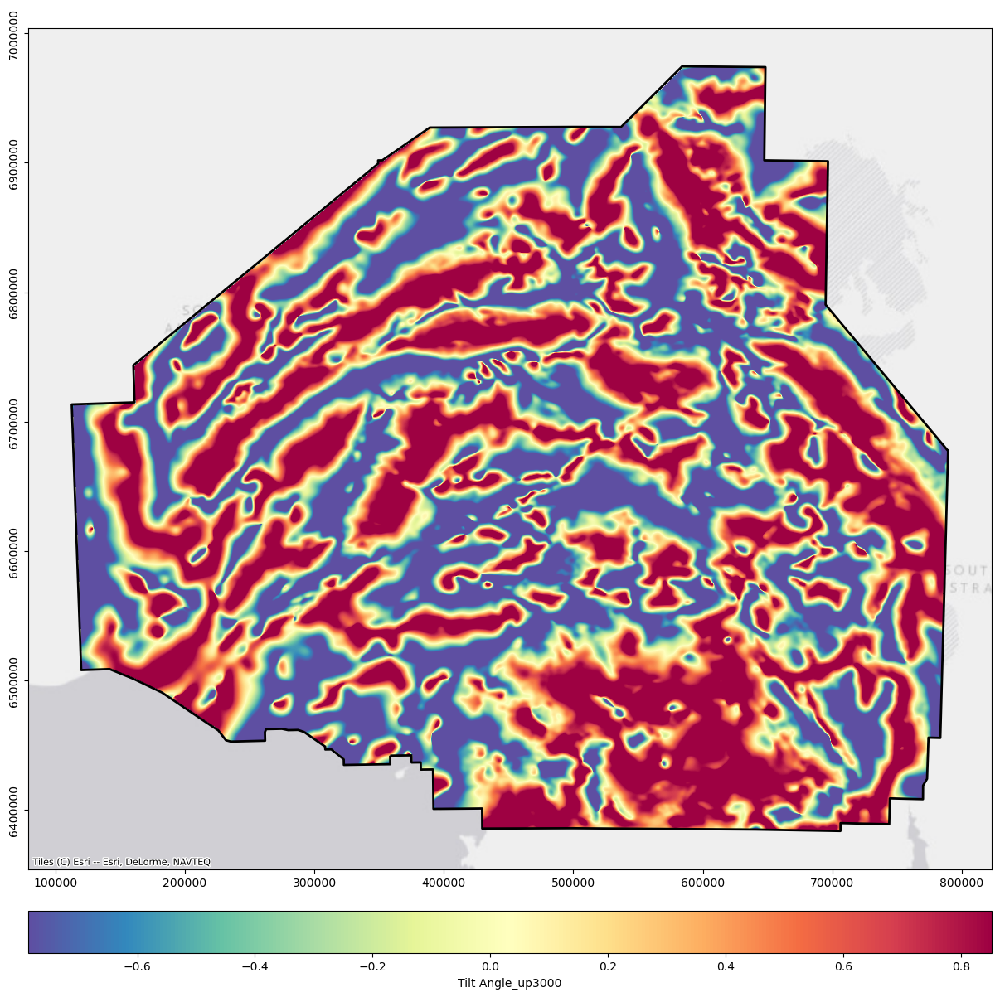

In [59]:
tilt_angle_file = './Datasets/Gravity/New/tilt_angle_up3000.tiff'

if not os.path.isfile(tilt_angle_file):
    # tilt angle
    tilt_angle_up3000 = filtering.my_tilt(lons_2d, lats_2d, upcont3000)
    tilt_angle_2d = np.reshape(tilt_angle_up3000, np.shape(upcont3000))
    save_tiff(tilt_angle_2d, 'tilt_angle_up3000')

tilt_angle_up3000 = rxr.open_rasterio(tilt_angle_file, masked=True).squeeze()
tilt_angle_clipped = tilt_angle_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
tilt_angle_clipped_array = tilt_angle_clipped.values
plot_array_stretched(tilt_angle_clipped_array, 'Tilt Angle_up3000')

## Horizontal Tilt Angle

In [60]:
### Horizontal Tilt Angle Upward Continuation (500 m)

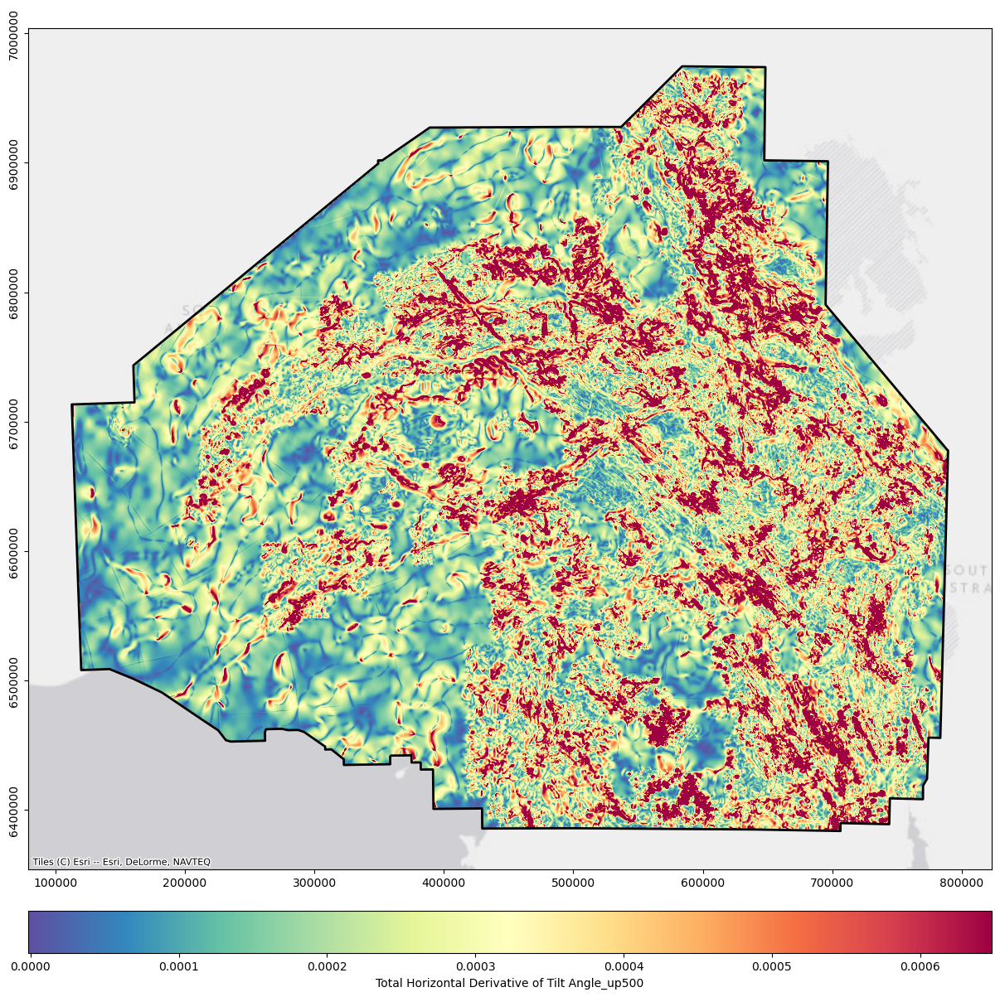

In [61]:
thd_file = './Datasets/Gravity/New/thd_up500.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up500 = filtering.my_thdr(lons_2d, lats_2d, upcont500)
    thd_2d = np.reshape(thd_up500, np.shape(upcont500))
    save_tiff(thd_2d, 'thd_up500')

thd_up500 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up500.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up500')

In [62]:
### Horizontal Tilt Angle Upward Continuation (1000 m)

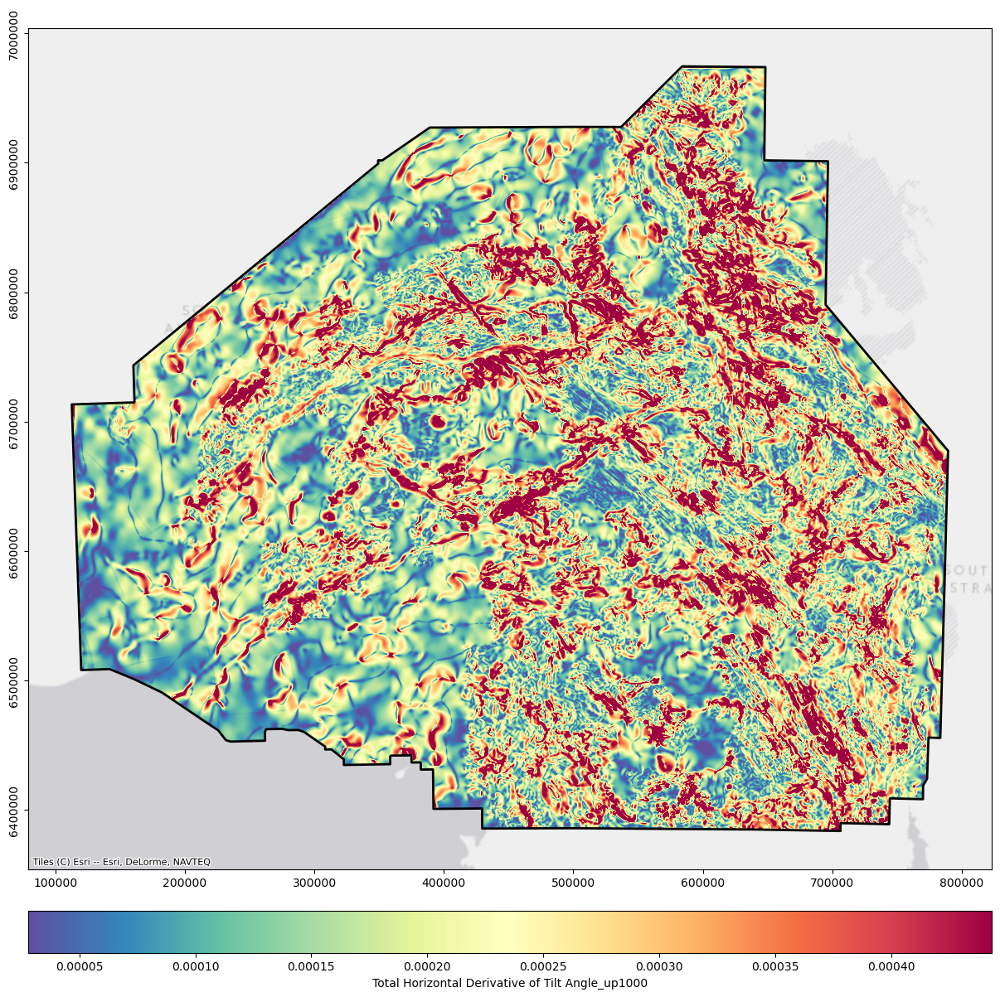

In [63]:
thd_file = './Datasets/Gravity/New/thd_up1000.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up1000 = filtering.my_thdr(lons_2d, lats_2d, upcont1000)
    thd_2d = np.reshape(thd_up1000, np.shape(upcont1000))
    save_tiff(thd_2d, 'thd_up1000')

thd_up1000 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up1000.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up1000')

In [64]:
### Horizontal Tilt Angle Upward Continuation (2000 m)

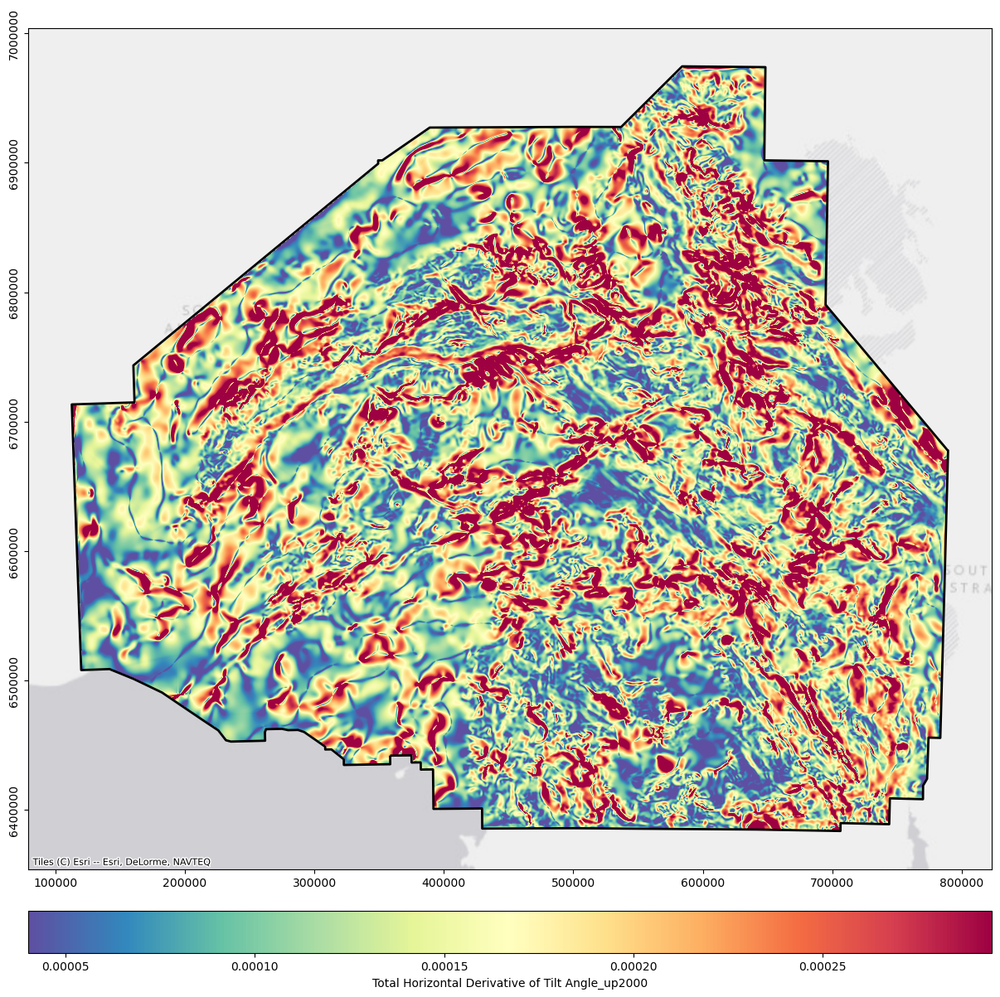

In [65]:
thd_file = './Datasets/Gravity/New/thd_up2000.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up2000 = filtering.my_thdr(lons_2d, lats_2d, upcont2000)
    thd_2d = np.reshape(thd_up2000, np.shape(upcont2000))
    save_tiff(thd_2d, 'thd_up2000')

thd_up2000 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up2000.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up2000')

In [66]:
### Horizontal Tilt Angle Upward Continuation (3000 m)

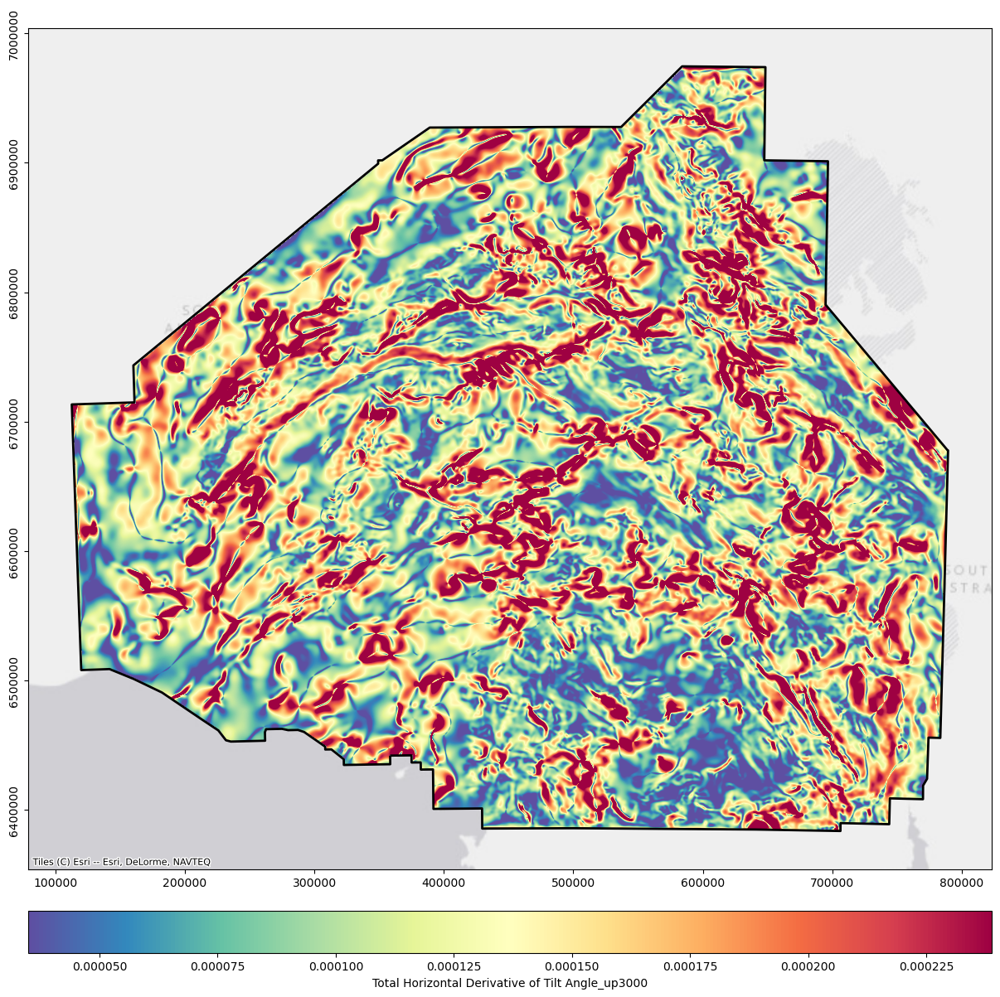

In [67]:
thd_file = './Datasets/Gravity/New/thd_up3000.tiff'

if not os.path.isfile(thd_file):
    # total horizontal derivative of tilt angle
    thd_up3000 = filtering.my_thdr(lons_2d, lats_2d, upcont3000)
    thd_2d = np.reshape(thd_up3000, np.shape(upcont3000))
    save_tiff(thd_2d, 'thd_up3000')

thd_up3000 = rxr.open_rasterio(thd_file, masked=True).squeeze()
thd_clipped = thd_up3000.rio.clip(gc_polygon.geometry.apply(mapping))
thd_clipped_array = thd_clipped.values
plot_array_stretched(thd_clipped_array, 'Total Horizontal Derivative of Tilt Angle_up3000')

# Extracting Features from GLCM

In [68]:
def get_grid_data(xs, ys, grids, columns):
    grid_features = []

    for count, grid in enumerate(grids):
        print(count+1, '/', len(grids))
        raster = rxr.open_rasterio(grid, masked=True).squeeze()
        bounds = (raster.rio.bounds())
        raster_np = raster.values
        
        means, stds = get_mean_std(xs, ys, raster_np, bounds, 5000)
        grid_features.append(means)
        grid_features.append(stds)

        dissimilarity, correlation = get_glcm(xs, ys, raster_np, bounds, 10000)
        grid_features.append(dissimilarity)
        grid_features.append(correlation)
        
        del raster
        del raster_np

    return pd.DataFrame(np.array(grid_features).T, columns=columns)

grav_filenames_02 = [
    './Datasets/Gravity/New/upcont500.tiff',
    './Datasets/Gravity/New/upcont1000.tiff',
    './Datasets/Gravity/New/upcont2000.tiff',
    './Datasets/Gravity/New/upcont3000.tiff',

    
    './Datasets/Gravity/New/deriv_x_up500.tiff',
    './Datasets/Gravity/New/deriv_x_up1000.tiff',
    './Datasets/Gravity/New/deriv_x_up2000.tiff',
    './Datasets/Gravity/New/deriv_x_up3000.tiff',
    
    './Datasets/Gravity/New/deriv_y_up500.tiff',
    './Datasets/Gravity/New/deriv_y_up1000.tiff',
    './Datasets/Gravity/New/deriv_y_up2000.tiff',
    './Datasets/Gravity/New/deriv_y_up3000.tiff',
    
    # './Datasets/Gravity/New/deriv_z.tiff',
    
    './Datasets/Gravity/New/hga_up500.tiff',
    './Datasets/Gravity/New/hga_up1000.tiff',
    './Datasets/Gravity/New/hga_up2000.tiff',
    './Datasets/Gravity/New/hga_up3000.tiff',
    
    './Datasets/Gravity/New/tga_up500.tiff',
    './Datasets/Gravity/New/tga_up1000.tiff',
    './Datasets/Gravity/New/tga_up2000.tiff',
    './Datasets/Gravity/New/tga_up3000.tiff',

    './Datasets/Gravity/New/thd_up500.tiff',
    './Datasets/Gravity/New/thd_up1000.tiff',
    './Datasets/Gravity/New/thd_up2000.tiff',
    './Datasets/Gravity/New/thd_up3000.tiff',

    './Datasets/Gravity/New/tilt_angle_up500.tiff',
    './Datasets/Gravity/New/tilt_angle_up1000.tiff',
    './Datasets/Gravity/New/tilt_angle_up2000.tiff',
    './Datasets/Gravity/New/tilt_angle_up3000.tiff',
    ]

column_names_02 = []

for file in grav_filenames_02:
    prefix = os.path.splitext(os.path.basename(file))[0]
    column_names_02.append(prefix+'_mean')
    column_names_02.append(prefix+'_std')
    column_names_02.append(prefix+'_dissimilarity')
    column_names_02.append(prefix+'_correlation')

grav_features_file_02 = './Gravity Features.csv'

if os.path.isfile(grav_features_file_02):
    print('The gravity features (new data layers) already exist.')
    grav_features_02 = pd.read_csv(grav_features_file_02, index_col=False)
else:
    grav_features_02 = get_grid_data(xs_flat, ys_flat, grav_filenames_02, column_names_02)
    grav_features_02.to_csv(grav_features_file_02, index=False)
    print(f'The gravity features (new data layers) have been saved to {grav_features_file_02}.')

@interact(feature=column_names_02)
def show_dist(feature):
    array = np.flipud(grav_features_02[feature].values.reshape(ny, nx))
    array_copy = array.copy()
    array_copy[~mask_2d_ud] = float('nan')
    plot_array_stretched(array_copy, feature)

The gravity features (new data layers) already exist.


interactive(children=(Dropdown(description='feature', options=('upcont500_mean', 'upcont500_std', 'upcont500_d…

# PCA

In [69]:
grav_features_file = './Gravity Features.csv'

if os.path.isfile(grav_features_file):
    print('The gravity features already exist.')
    grav_features = pd.read_csv(grav_features_file, index_col=False)
else:
    grav_features = pd.concat([grav_features_01, grav_features_02], axis=1).reset_index(drop=True)
    grav_features.to_csv(grav_features_file, index=False)
    print(f'The gravity features have been saved to {grav_features_file}.')

# pca
pca = PCA()
components = pca.fit_transform(grav_features)
var_ratio = pca.explained_variance_ratio_
var_sum = 0

for i in range(len(var_ratio)):
    if var_sum >= 0.99:
        break
    else:
        var_sum += var_ratio[i]

selected_components = components[:, :i]
print('Number of input features:', grav_features.shape[1])
print('Number of components:', selected_components.shape[1])

@interact(pc_num=list(range(1, selected_components.shape[1]+1)))
def show_map(pc_num):
    pc = selected_components[:, pc_num-1]
    pc_2d = np.reshape(pc, (ny, nx))
    pc_2d_ud = np.flipud(pc_2d)
    pc_2d_ud_copy = pc_2d_ud.copy()
    pc_2d_ud_copy[~mask_2d_ud] = float('nan')
    plot_array_stretched(pc_2d_ud_copy, 'PC')

The gravity features already exist.
Number of input features: 112
Number of components: 10


interactive(children=(Dropdown(description='pc_num', options=(1, 2, 3, 4, 5, 6, 7, 8, 9, 10), value=1), Output…

# Elbow Method

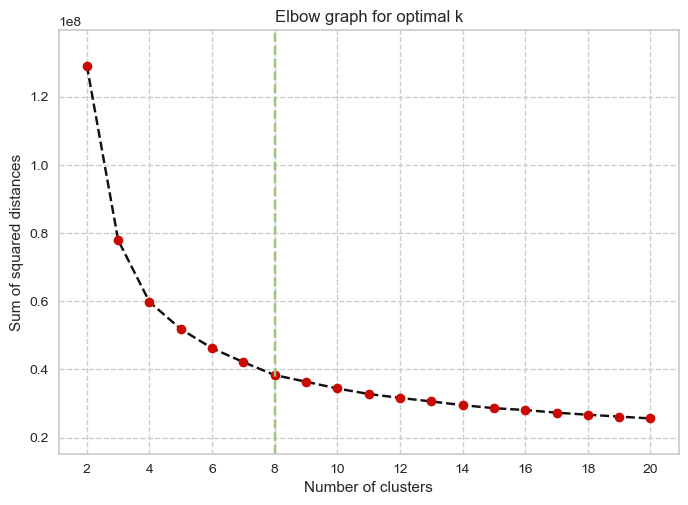

In [70]:
from yellowbrick.cluster import KElbowVisualizer

# two options for plotting the elbow graph
# option 1 without using the yellowbrick library
sum_squared_distance = []
range_n_clusters = range(2, 21)
for k in range_n_clusters:
    clusterer = cluster.KMeans(n_clusters=k, random_state=1)
    clusterer.fit(selected_components)
    sum_squared_distance.append(clusterer.inertia_)

range_ssd = max(sum_squared_distance) - min(sum_squared_distance)

plt.plot(range_n_clusters, sum_squared_distance, 'ko--', mfc='r')
plt.vlines(x=8, ymin=min(sum_squared_distance)-(0.1*range_ssd),
           ymax=max(sum_squared_distance)+(0.1*range_ssd), color='g', linestyles='dashed')
plt.xticks(range(2, 21, 2))
plt.ylim(min(sum_squared_distance)-(0.1*range_ssd), max(sum_squared_distance)+(0.1*range_ssd))
plt.xlabel('Number of clusters')
plt.ylabel('Sum of squared distances')
plt.title('Elbow graph for optimal k')
plt.grid(linestyle='--')
plt.show()

# # option 2 using the yellowbrick library
# visualizer = KElbowVisualizer(cluster.KMeans(random_state=1), k=(2, 21), timings=True)
# # fit the data
# visualizer.fit(selected_components)
# # finalize and render figure
# visualizer.show()

# Clustering k-means

## Optimization of Hyperparameters

In [71]:
%%time
from sklearn import cluster
from sklearn.metrics import silhouette_score
import random

# Define hyperparameter ranges
n_init_range = range(1, 10, 2)  # From 1 to 10 with intervals of 2
max_iter_range = range(1, 1000, 100)  # From 1 to 1000 with intervals of 100
tolerance_range = np.arange(1, 10, 2)  # From 1 to 10 with intervals of 2

# Fixed hyperparameters
n_clusters = 8  # Number of clusters
init_method = 'k-means++'  # Method for initialization
random_state = 1  # Random state for reproducibility

# Select a random subset of parameter combinations
random_init = random.sample(list(n_init_range), 3)
random_max_iter = random.sample(list(max_iter_range), 3)
random_tolerance = random.sample(list(tolerance_range), 3)

# Initialize variables to store the best parameters and performance
best_score = -1
best_params = {}

# Loop over all parameter combinations
for n_init, max_iter, tolerance in zip(random_init, random_max_iter, random_tolerance):
    # k-means clustering using the components
    k_means = cluster.KMeans(n_clusters=n_clusters, init=init_method, n_init=n_init,
                             max_iter=max_iter, tol=tolerance, random_state=random_state)

    # Train the model
    pred = k_means.fit_predict(selected_components)

    # Compute silhouette score
    score = silhouette_score(selected_components, pred)
    
    # Update best parameters if the current silhouette score is higher
    if score > best_score:
        best_score = score
        best_params = {'n_init': n_init, 'max_iter': max_iter, 'tolerance': tolerance}

# Print the best parameters and performance
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_score)

Best Parameters: {'n_init': 5, 'max_iter': 701, 'tolerance': 5}
Best Silhouette Score: 0.20946276546500547
CPU times: total: 14min 43s
Wall time: 9min 27s


In [ ]:
# Best Parameters: {'n_init': 5, 'max_iter': 701, 'tolerance': 5}
# Best Silhouette Score: 0.20946276546500547
# CPU times: total: 14min 43s
# Wall time: 9min 27s

## k-means clustering result

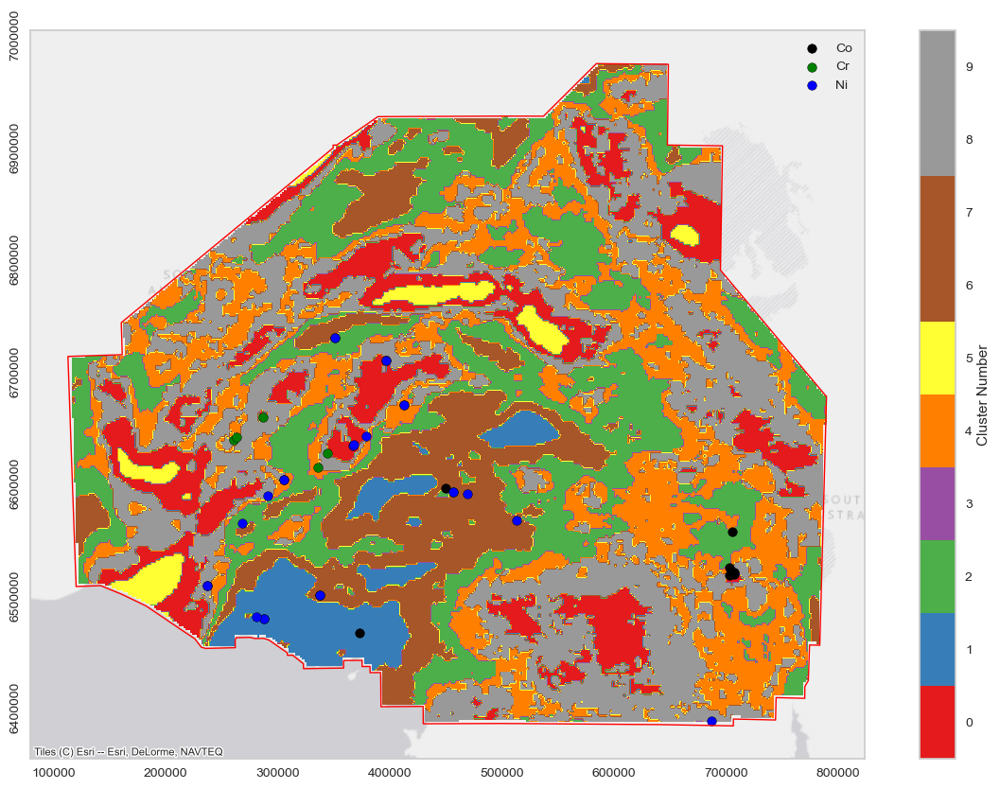

In [71]:
from sklearn import cluster
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import contextily as cx
from matplotlib import cm

# Fixed hyperparameters for KMeans with adjusted speed
n_clusters = 10  # Number of clusters
init_method = 'k-means++'  # Method for initialization
n_init = 5  # Number of times the k-means algorithm will be run with different centroid seeds (reduced from 10)
max_iter = 701  # Maximum number of iterations of the k-means algorithm for a single run (reduced from 300)
tolerance = 5  # Tolerance to declare convergence

# k-means clustering using the components generated in the previous cell
k_means = cluster.KMeans(n_clusters=n_clusters, init=init_method, n_init=n_init,
                         max_iter=max_iter, tol=tolerance, random_state=1)

# Train the model
pred = k_means.fit_predict(selected_components)

# Get cluster labels
labels = k_means.labels_

# Reshape labels
labels = labels.reshape((ny, nx))
labels = labels.astype('float')
labels = np.flipud(labels)
labels[~mask_2d_ud] = float('nan')

# Plotting
fig, ax = plt.subplots(figsize=(15, 10))
mines_co.plot(ax=ax, edgecolor='black', color='black')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
cmap = cm.get_cmap('Set1', n_clusters)
plt.imshow(labels, cmap=cmap, extent=extent)
cbar = plt.colorbar(label='Cluster Number')
tick_locs = (np.arange(n_clusters) + 0.5)*(n_clusters-1)/n_clusters
cbar.set_ticks(tick_locs)
cbar.set_ticklabels(np.arange(n_clusters))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

In [72]:
# Get the unique values in som_labels as a list
unique_values_list = np.unique(labels).tolist()
print("Unique values in labels:", unique_values_list)
print("Number of unique values:", len(unique_values_list))

Unique values in labels: [0.0, 1.0, 2.0, 4.0, 5.0, 6.0, 8.0, 9.0, nan]
Number of unique values: 9


In [74]:
# export an array to a GeoTIFF file
def save_tiff_output(array, index):
    dist_x = 2000
    dist_y = 2000
    geotransform = (extent[0], dist_x, 0, extent[3], 0, -dist_y)
    map_file = f'./Datasets/Output/{index}.tiff'
    driver = gdal.GetDriverByName('GTiff')
    nx = array.shape[1]
    ny = array.shape[0]
    dataset = driver.Create(map_file, nx, ny, 1, gdal.GDT_Float32)
    dataset.SetGeoTransform(geotransform)
    srs = osr.SpatialReference()
    srs.ImportFromEPSG(7853)
    dataset.SetProjection(srs.ExportToWkt())
    dataset.GetRasterBand(1).WriteArray(array)
    dataset.FlushCache()
    dataset = None

In [75]:
save_tiff_output(labels, 'Shallow_Grav_Kmeans')

# Clustering SOM

## Optimization of Hyperparameters

In [81]:
from minisom import MiniSom
from sklearn.metrics import silhouette_score
import numpy as np
import random

input_len = len(selected_components[0])  # Adjust this according to your input data dimensionality

# Define the parameter ranges
som_rows_range = list(range(5, 31, 5))
som_cols_range = list(range(5, 31, 5))
sigma_range = list(range(1, 10, 2))
learning_rate_range = list(np.arange(0, 1.1, 0.2))
iterations_range = list(range(100, 1001, 200))

# Randomly sample a subset of parameter combinations
parameter_combinations = list(zip(random.sample(som_rows_range, 3),
                                  random.sample(som_cols_range, 3),
                                  random.sample(sigma_range, 3),
                                  random.sample(learning_rate_range, 3),
                                  random.sample(iterations_range, 3)))

# Initialize variables to store the best parameters and performance
best_params = {}
best_performance = -1  # Initialize with a low value as silhouette score ranges from -1 to 1 (higher is better)

# Loop over all parameter combinations
for som_rows, som_cols, sigma, learning_rate, iterations in parameter_combinations:
    # Initialize the SOM
    som = MiniSom(som_rows, som_cols, input_len, sigma=sigma, learning_rate=learning_rate)
    
    # Train the SOM with current parameters
    som.train_batch(selected_components, iterations)
    
    # Assign each sample to its closest neuron
    pred = np.array([som.winner(x) for x in selected_components])
    
    # Flatten the SOM grid to get cluster labels
    som_labels = np.ravel_multi_index(pred.T, (som_rows, som_cols))
    
    # Compute silhouette score
    silhouette = silhouette_score(selected_components, som_labels)
    
    # Update best parameters if the current silhouette score is higher
    if silhouette > best_performance:
        best_params = {'som_rows': som_rows, 'som_cols': som_cols, 'sigma': sigma, 'learning_rate': learning_rate, 'iterations': iterations}
        best_performance = silhouette

# Print the best parameters and performance
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_performance)

Best Parameters: {'som_rows': 15, 'som_cols': 10, 'sigma': 3, 'learning_rate': 1.0, 'iterations': 900}
Best Silhouette Score: -0.00565139847212919


In [ ]:
# Best Parameters: {'som_rows': 15, 'som_cols': 10, 'sigma': 3, 'learning_rate': 1.0, 'iterations': 900}
# Best Silhouette Score: -0.00565139847212919

## SOM Clustering result

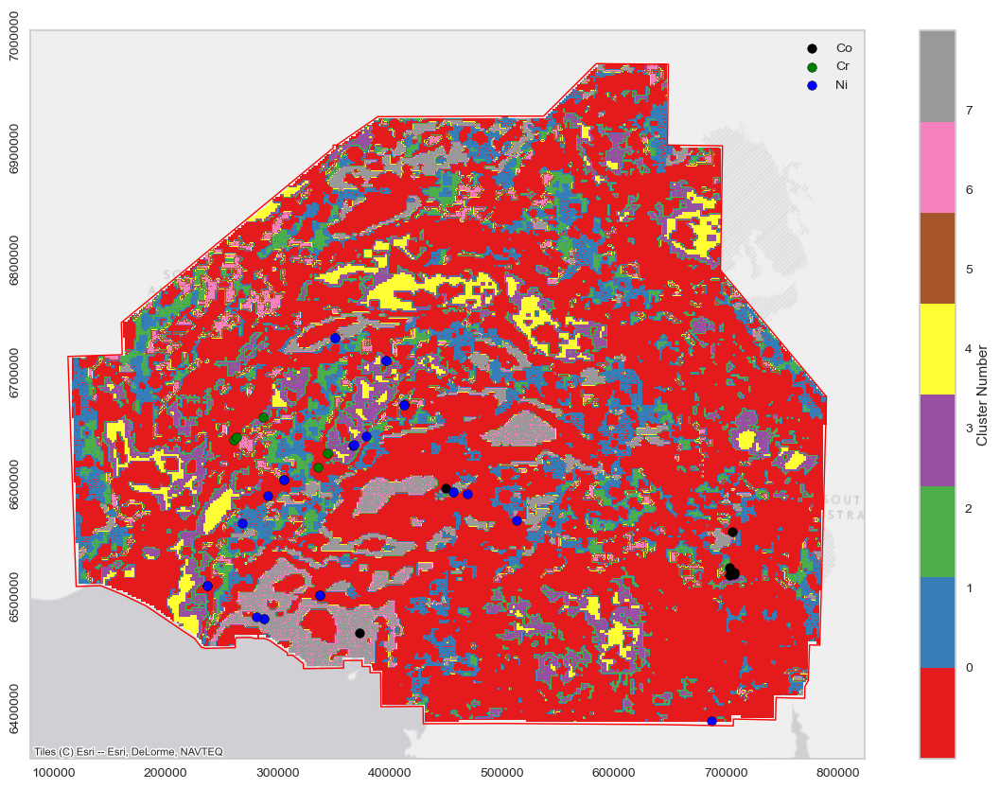

In [90]:
from minisom import MiniSom
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import contextily as cx
from matplotlib import cm
from collections import Counter  # Import Counter class

# Define SOM parameters
som_rows = 15  # Adjust the number of rows
som_cols = 10  # Adjust the number of columns
input_len = len(selected_components[0])  # Adjust this according to your input data dimensionality
sigma = 3  # Spread of the neighborhood function, adjust as needed
learning_rate = 1
num_clusters = 8  # Number of clusters

# Initialize the SOM
som = MiniSom(som_rows, som_cols, input_len, sigma=sigma, learning_rate=learning_rate)

# Train the SOM
som.train_batch(selected_components, 900)  # Adjust the number of iterations (2000 is an example)

# Assign each sample to its closest neuron
pred = np.array([som.winner(x) for x in selected_components])

# Flatten the SOM grid to get cluster labels
som_labels = np.ravel_multi_index(pred.T, (som_rows, som_cols))

# Find the top 8 most frequent cluster labels
top_labels = [label for label, count in Counter(som_labels).most_common(8)]

# Assign data points to the top 8 labels
som_labels = np.array([top_labels.index(label) if label in top_labels else -1 for label in som_labels])

# Reshape labels
som_labels = som_labels.reshape((ny, nx))
som_labels = som_labels.astype('float')
som_labels = np.flipud(som_labels)
som_labels[~mask_2d_ud] = float('nan')

# Plotting
fig, ax = plt.subplots(figsize=(15, 10))
mines_co.plot(ax=ax, edgecolor='black', color='black')
mines_cr.plot(ax=ax, edgecolor='black', color='green')
mines_ni.plot(ax=ax, edgecolor='black', color='blue')
gc_polygon.plot(ax=ax, edgecolor='red', color='none', linewidth=1)
cx.add_basemap(ax, crs='EPSG:7853', source=cx.providers.Esri.WorldGrayCanvas)
ax.yaxis.set_major_formatter(FormatStrFormatter('%.f'))
plt.yticks(rotation=90, va='center')
ax.xaxis.set_major_formatter(FormatStrFormatter('%.f'))
cmap = cm.get_cmap('Set1', num_clusters)  # Adjust the number of clusters here
plt.imshow(som_labels, cmap=cmap, extent=extent)
cbar = plt.colorbar(label='Cluster Number')
tick_locs = (np.arange(num_clusters) + 0.005) * (num_clusters - 1) / num_clusters
cbar.set_ticks(tick_locs)
cbar.set_ticklabels(np.arange(num_clusters))
plt.legend(['Co', 'Cr', 'Ni'])
plt.grid(False)
plt.show()

In [91]:
# Get the unique values in som_labels as a list
unique_values_list = np.unique(som_labels).tolist()
print("Unique values in som_labels:", unique_values_list)
print("Number of unique values:", len(unique_values_list))

Unique values in som_labels: [-1.0, 0.0, 1.0, 2.0, 3.0, 5.0, 6.0, 7.0, nan]
Number of unique values: 9


In [92]:
save_tiff_output(som_labels, 'Shallow_Grav_SOM')